# Bilateral filter:

The Bilateral filter is an improvement on the Gaussian filter, that guarantees the perseverance of edges.

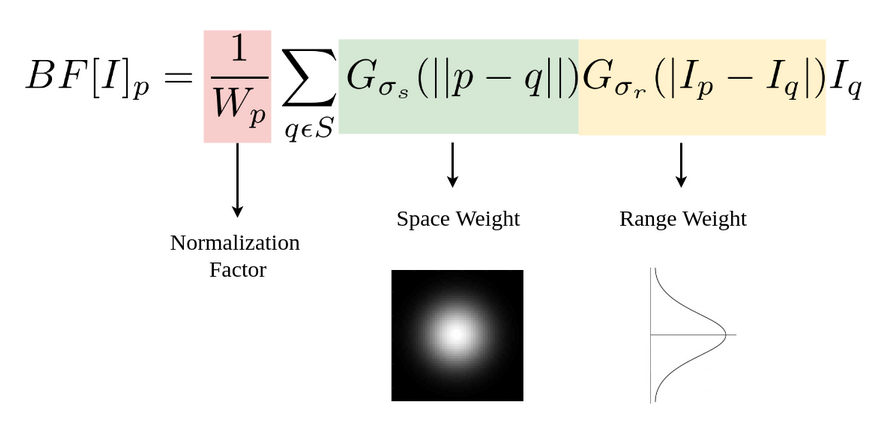

This filter doesn't only take colour intensity into consideration, but also spatial information.

Here, the normalization factor and the range weight are new terms added to the previous equation. Sigma_s denotes the spatial extent of the kernel, which is the size of the neighborhood, and sigma_r denotes the minimum amplitude of an edge. It ensures that only those pixels with intensity values similar to that of the central pixel are considered for blurring, while sharp intensity changes are maintained.

In [1]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import time
import numpy as np

In [35]:
Computational_times = {}
average_MSE = {}
average_psnr = {}

In [36]:
image_folder = '/content/original_images'

data = []

for filename in os.listdir(image_folder):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        img = cv2.imread(os.path.join(image_folder, filename))
        if img is not None:
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            data.append({'filename': filename, 'image': gray_img})

original = pd.DataFrame(data)

In [37]:
def apply_Bilateral_filter(image,scale, kernel_size=5,sigma_space=100, sigma_color=100):
  height,width = image.shape
  scaled_height = int(height*scale)
  scaled_width = int(width*scale)

  rescaled_image = cv2.resize(image,(scaled_width,scaled_height))

  filtered_image = cv2.bilateralFilter(rescaled_image,kernel_size,sigma_color,sigma_space)

  filtered_image = cv2.resize(filtered_image,(width,height,))

  return filtered_image

# Salt and Pepper noise:

In [39]:
def add_salt_pepper_noise(image, prob):
    noisy_image = image.copy()

    num_salt = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 1

    num_pepper = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0

    return noisy_image

noise_levels = [0.01, 0.08, 0.2]

noisy_data = []

for index, row in original.iterrows():
    for level in noise_levels:
        noisy_img = add_salt_pepper_noise(row['image'], level)
        noisy_data.append({
            'filename': f"{row['filename']}_noise_{level}",
            'image': noisy_img,
            'noise_level': level
        })


salty = pd.DataFrame(noisy_data)

In [64]:
Computational_times["Salt and Pepper"] = []
average_MSE["Salt and Pepper"] = []
average_psnr["Salt and Pepper"] = []

In [65]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=1, kernel_size=10, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 13.1083 seconds


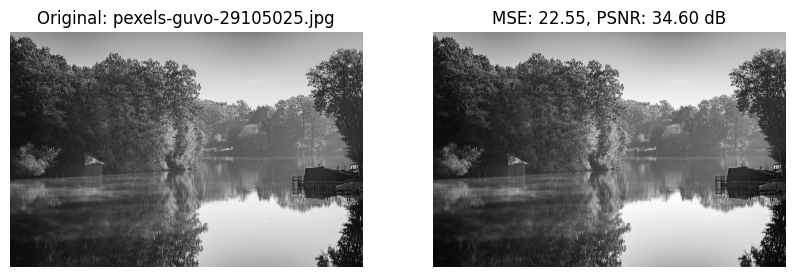

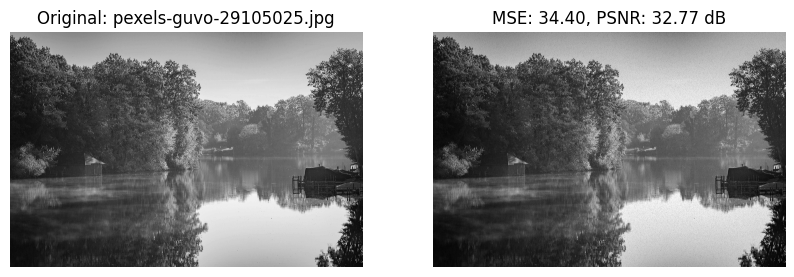

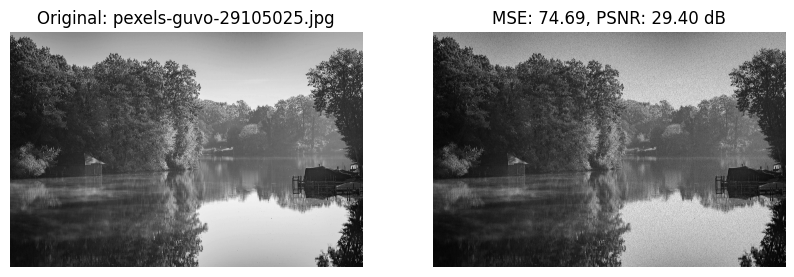

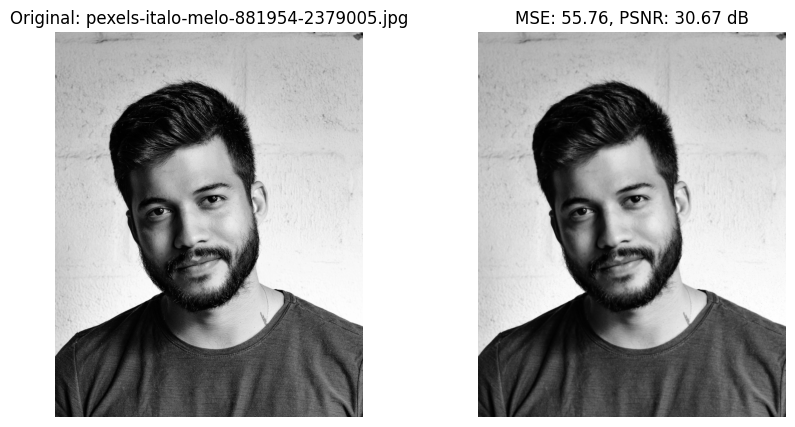

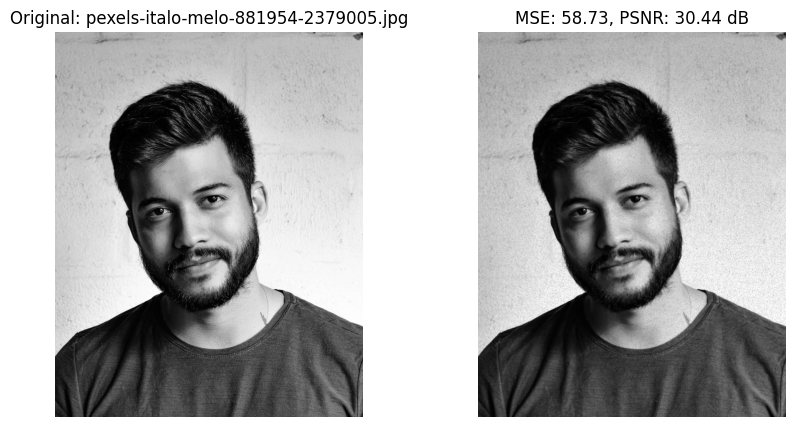

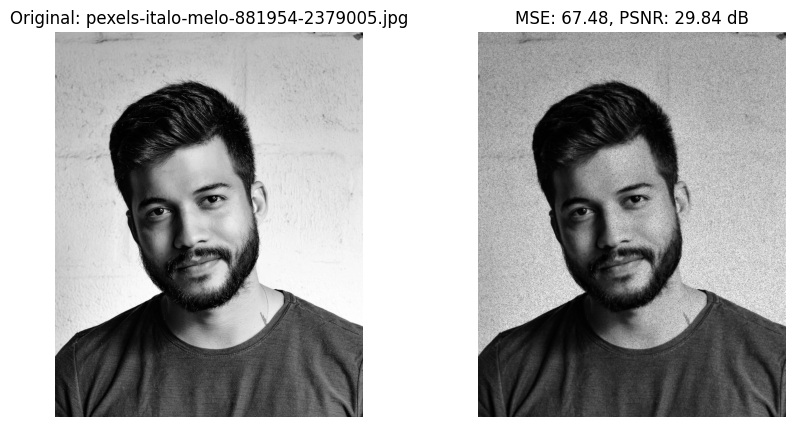

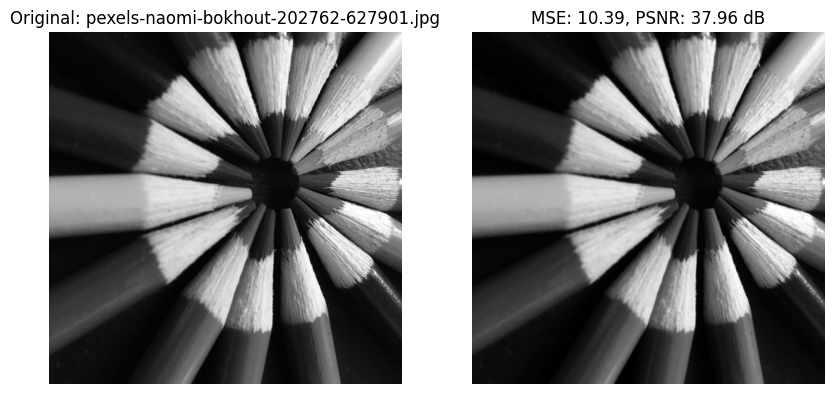

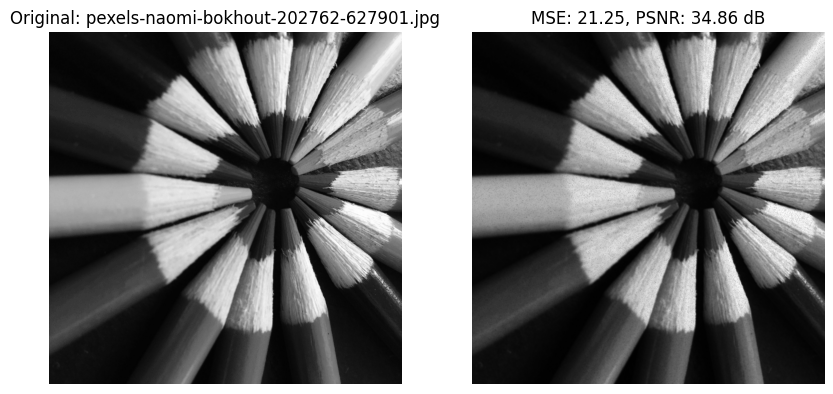

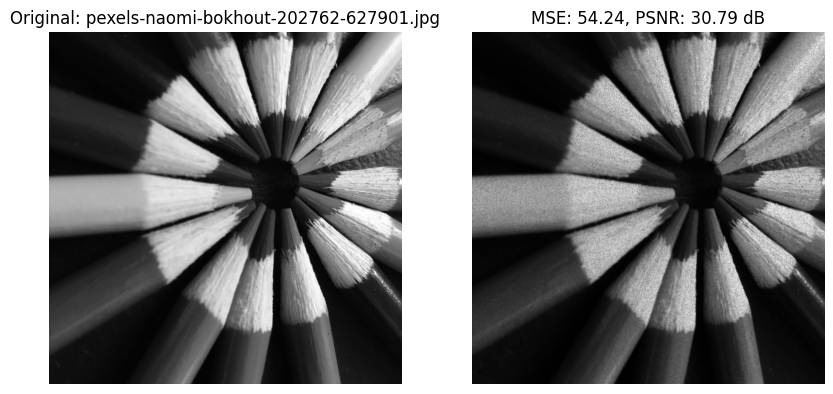

avarage mse = 44.38756073645119
avarage psnr = 32.36901519468507


In [66]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

The filter smoothed the images with low and average noise levels well, while the images with high levels of noise needed more smoothing. At the same time it's easy to notice that the strong edges are preserved well.




Let's prove that with Canny.

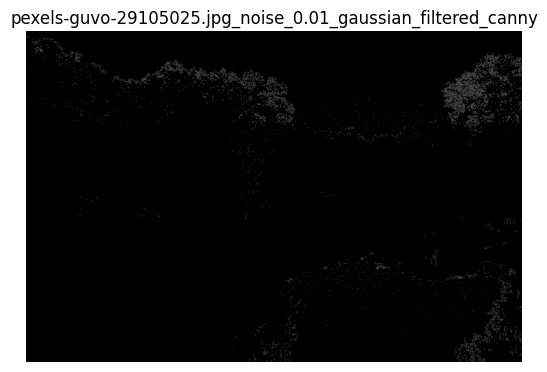

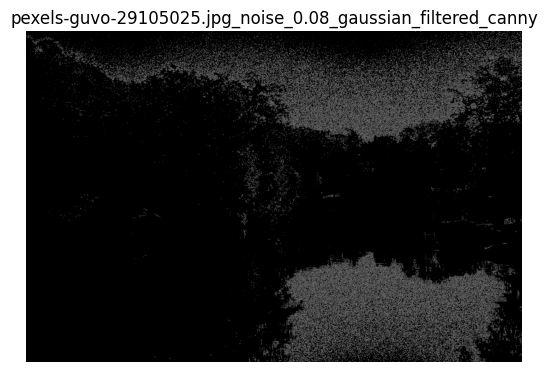

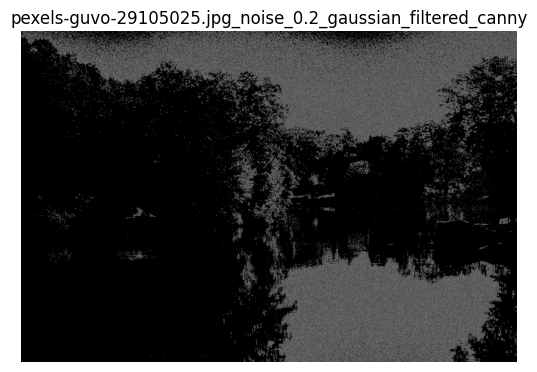

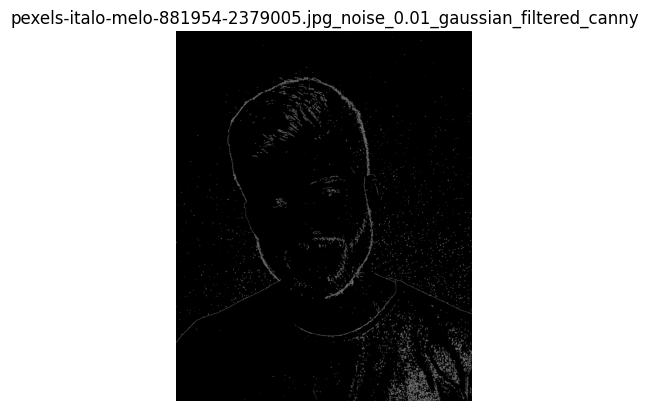

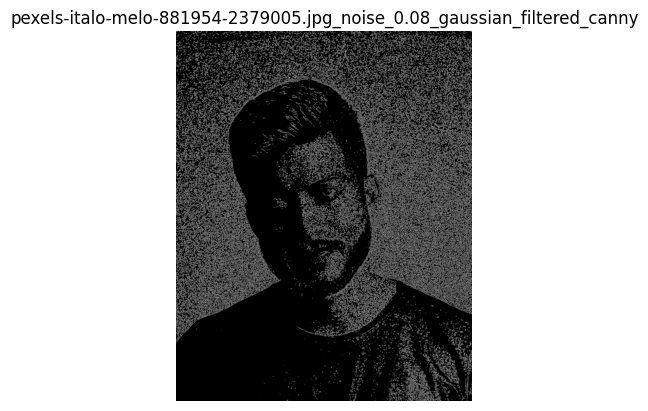

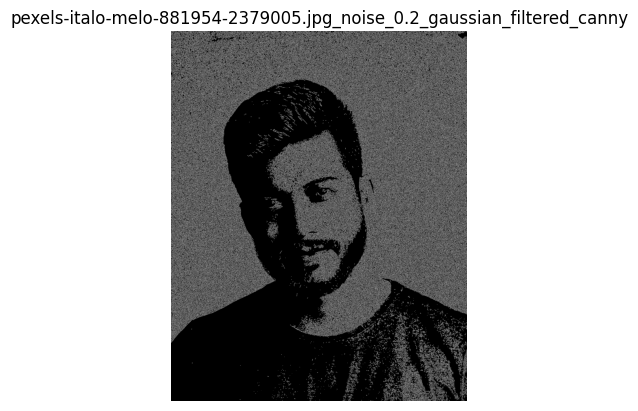

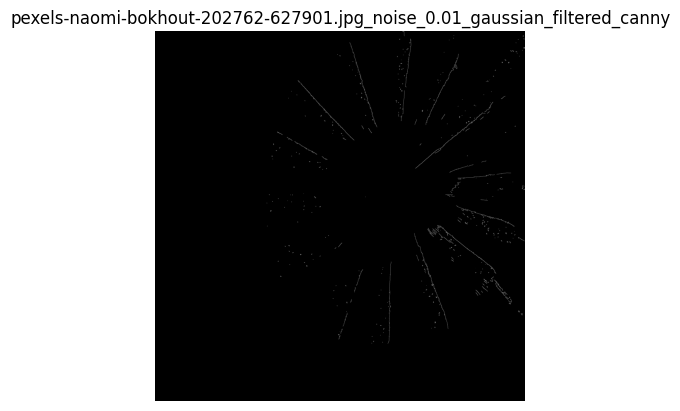

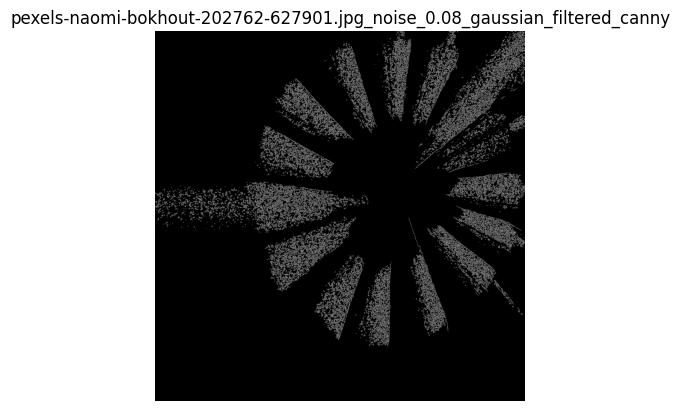

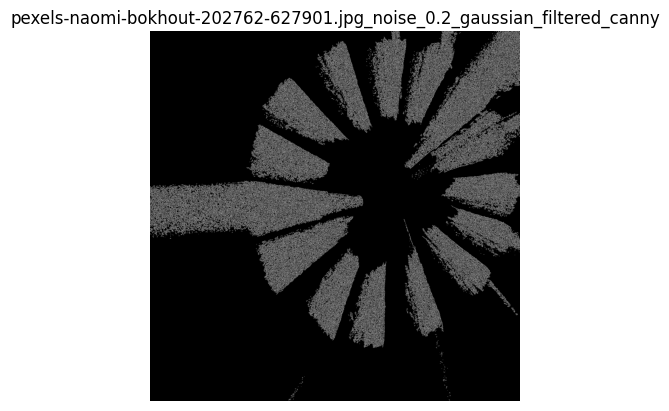

In [57]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

As can be seen in all images the strong edges are preserved. But in images with high level of noise, some of the noise got detected as edges. This means that the smoothing effect of the filter needs to be increased.

In [67]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=0.5, kernel_size=20, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 14.3914 seconds


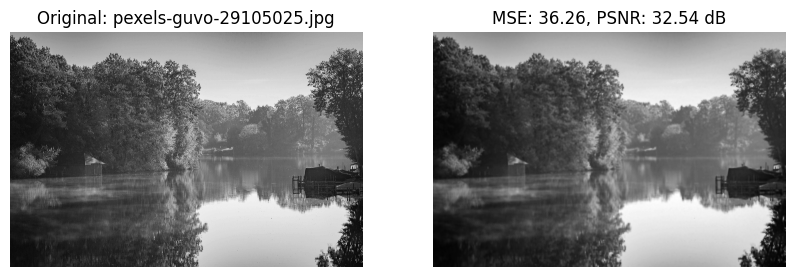

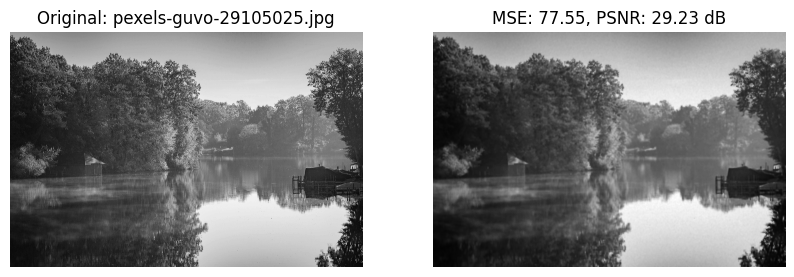

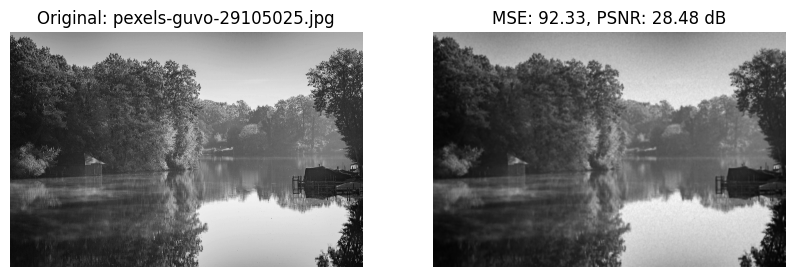

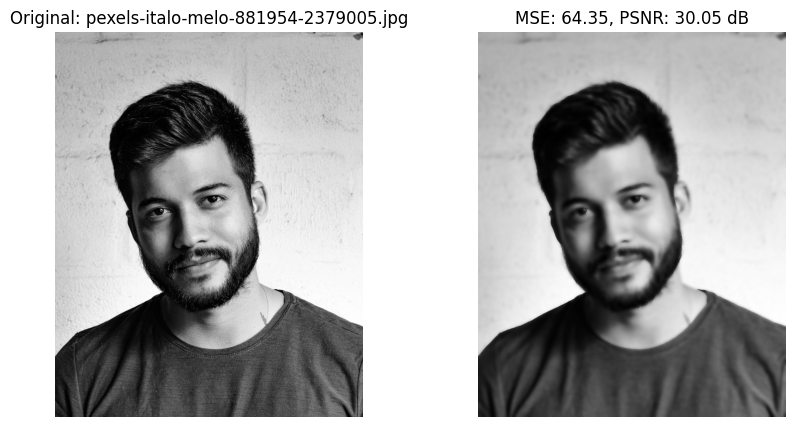

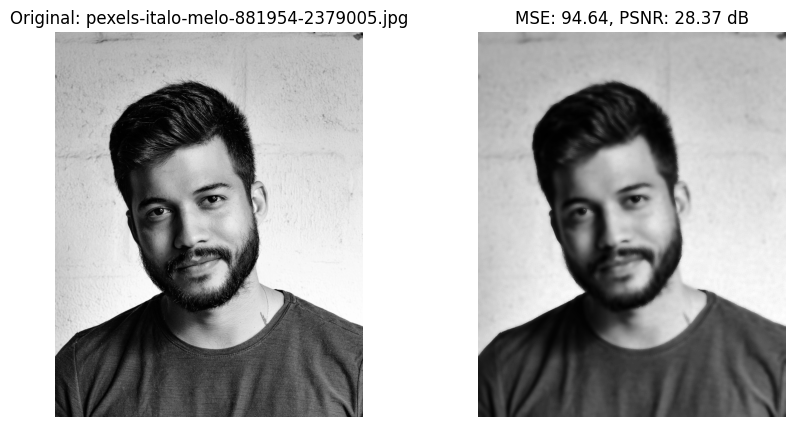

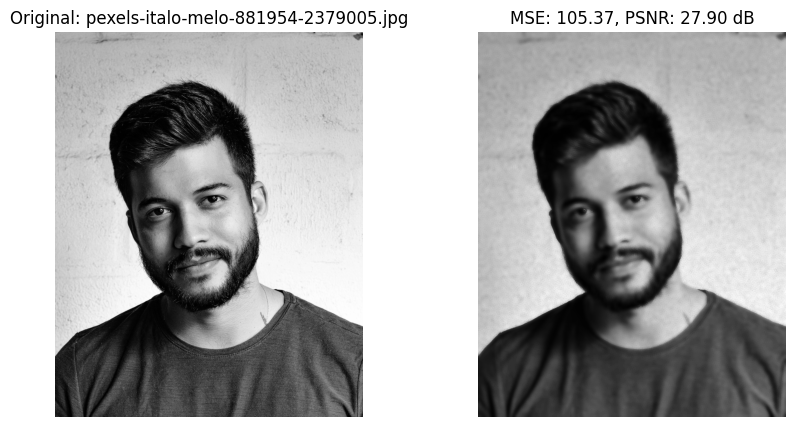

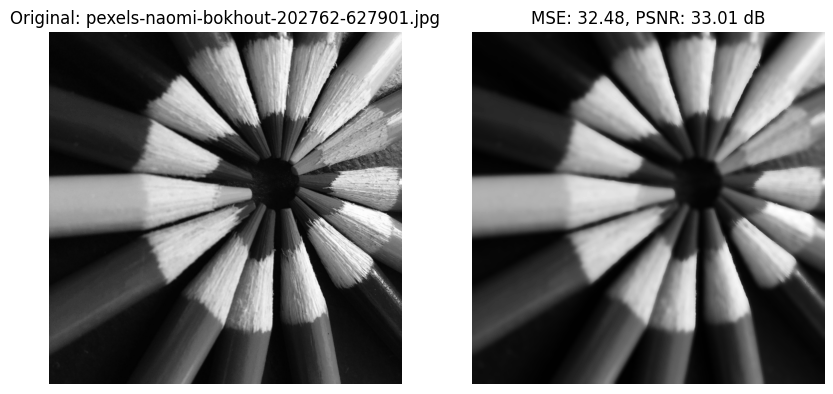

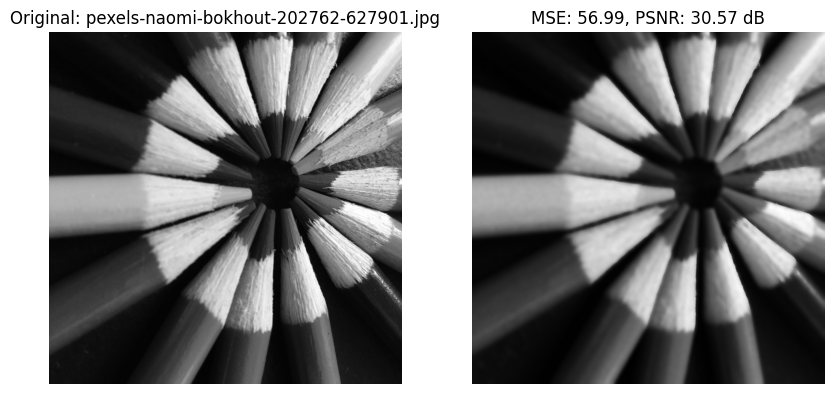

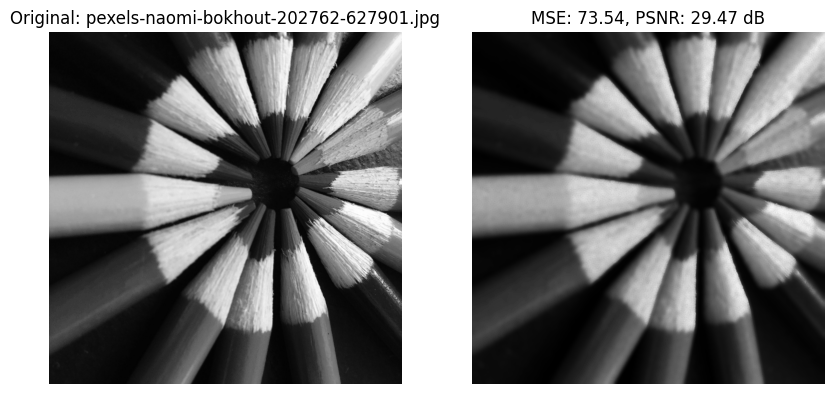

avarage mse = 70.39071279143448
avarage psnr = 29.957786335375097


In [69]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

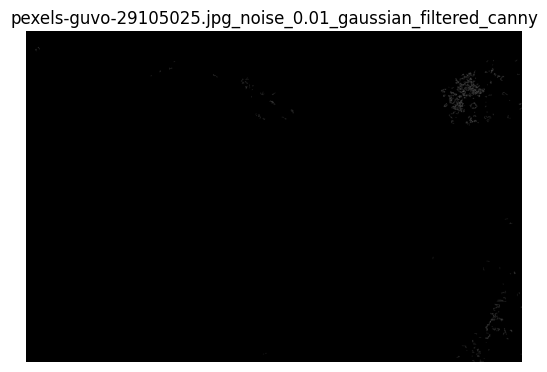

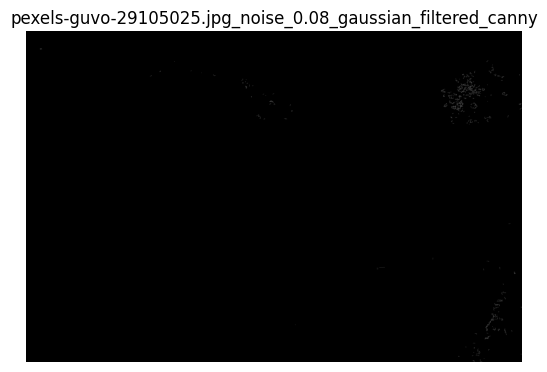

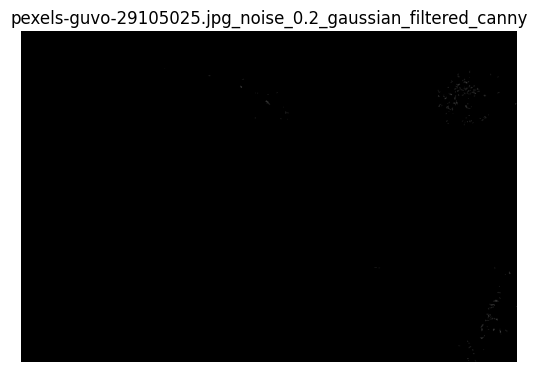

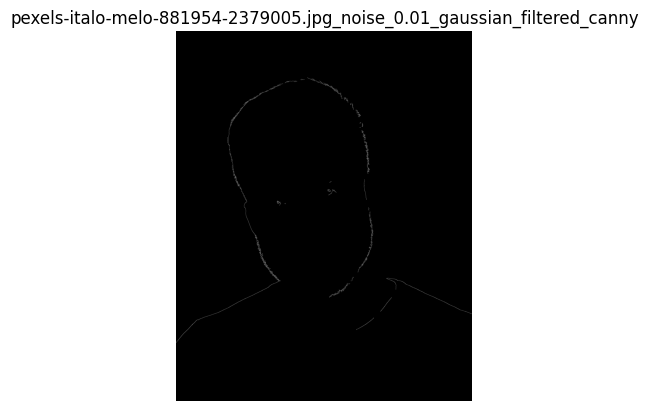

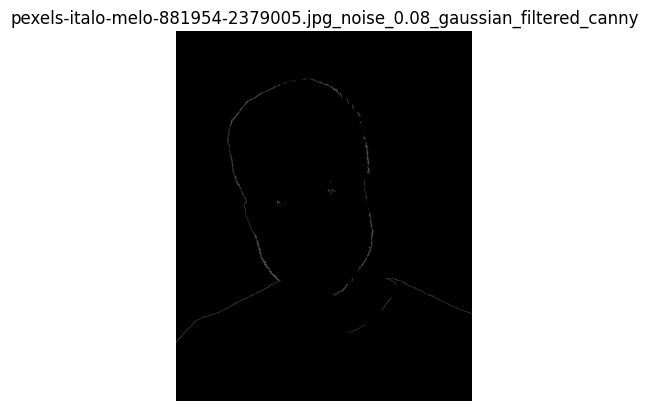

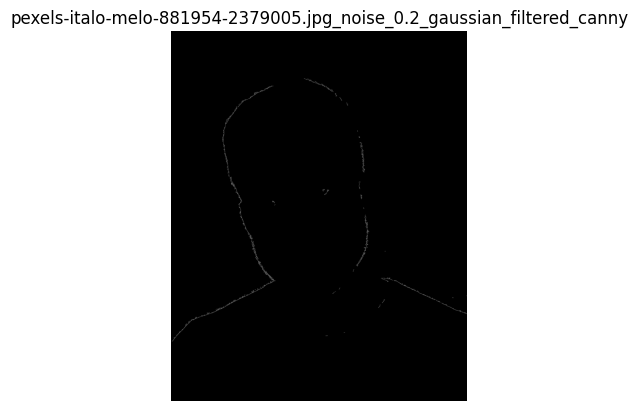

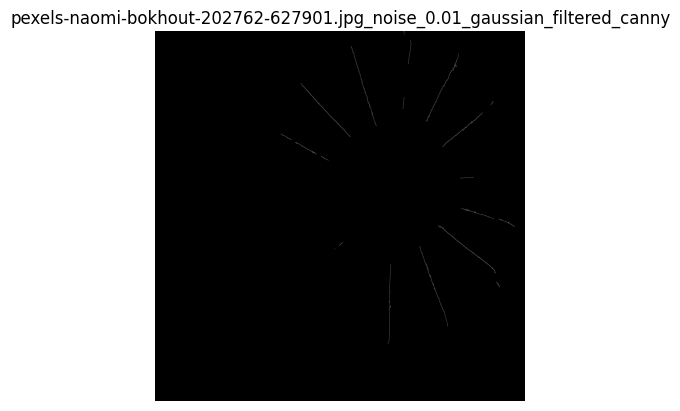

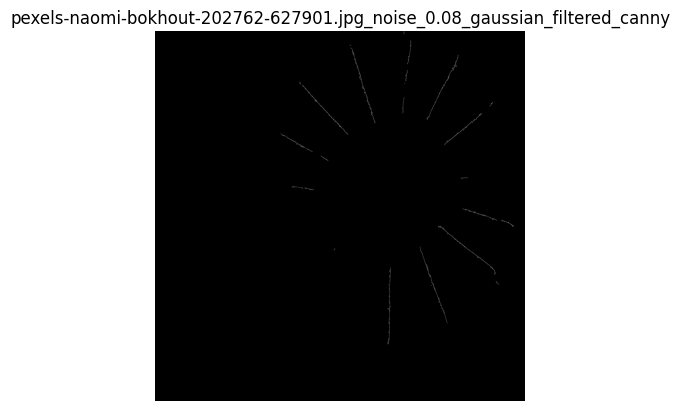

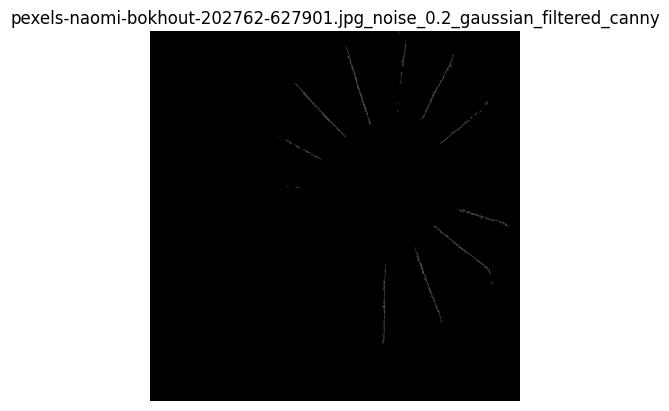

In [63]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

the images were smoothed more, but the edges still weren't lost, the evidence is Canny still detected the same edges, without the noise in all levels of noise.

# Gaussian noise:

In [70]:
def add_gaussian_noise(image, var, mean=20):
    sigma = var**0.5
    gaussian_noise = np.random.normal(mean, sigma, image.shape)

    noisy_image = image + gaussian_noise

    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image

gaussian_variances = [500, 1000, 2000]

noisy_data_gaussian = []

for index, row in original.iterrows():
    for var in gaussian_variances:
        noisy_img = add_gaussian_noise(row['image'], var=var)
        noisy_data_gaussian.append({
            'filename': f"{row['filename']}_gaussian_{var}",
            'image': noisy_img,
            'variance': var
        })

gaussian_noise = pd.DataFrame(noisy_data_gaussian)

In [80]:
Computational_times["Gaussian"] = []
average_MSE["Gaussian"] = []
average_psnr["Gaussian"] = []

In [81]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=1, kernel_size=10, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_bilateral_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 14.0850 seconds


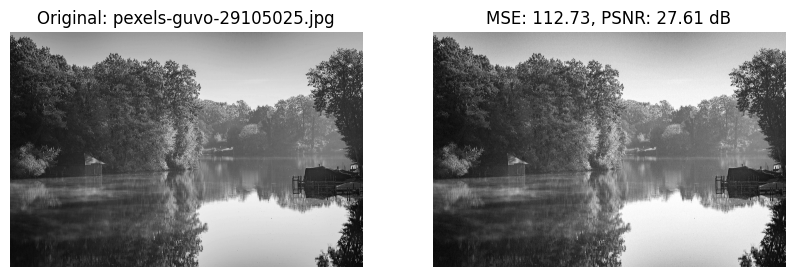

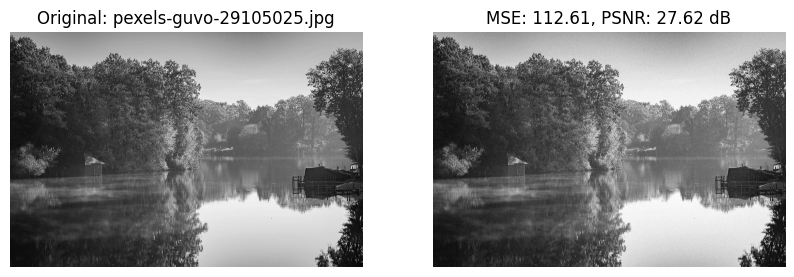

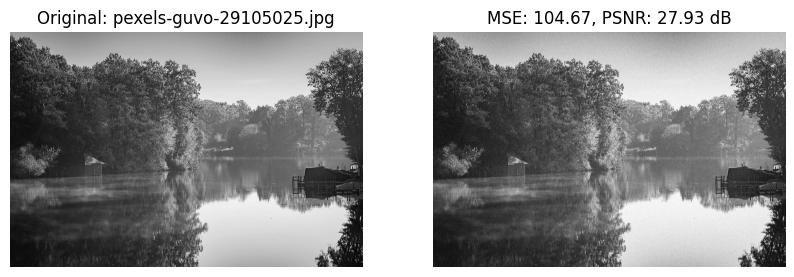

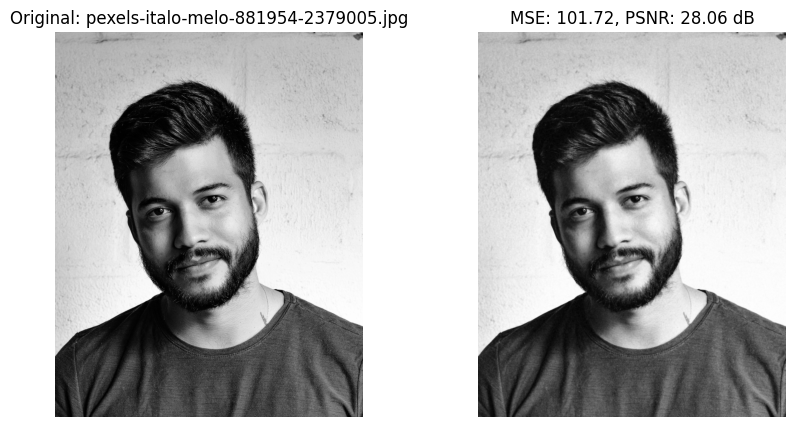

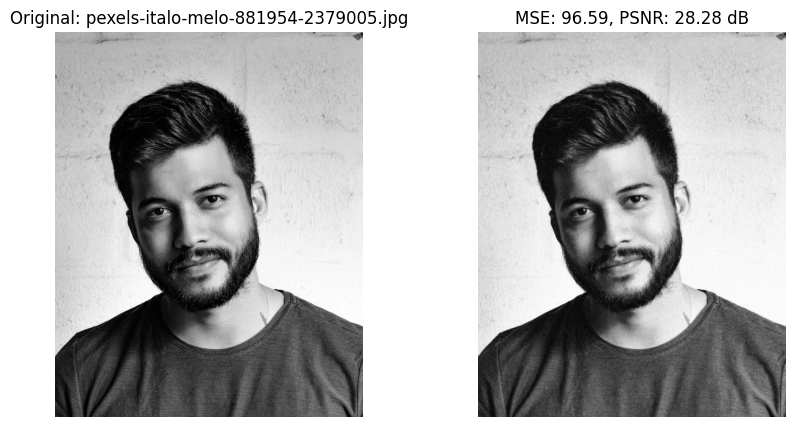

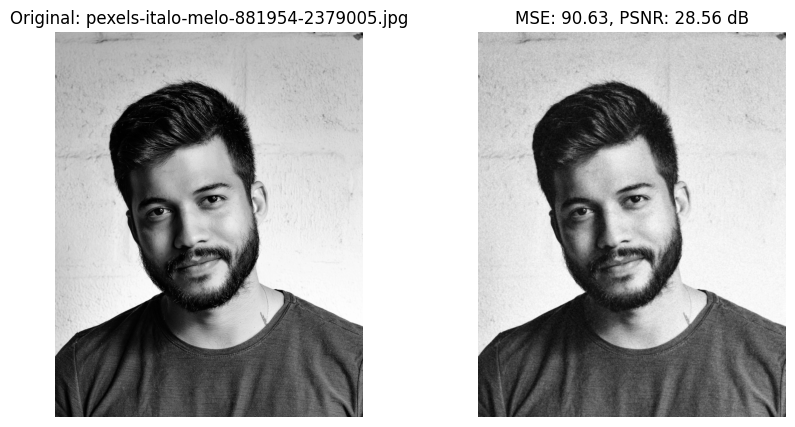

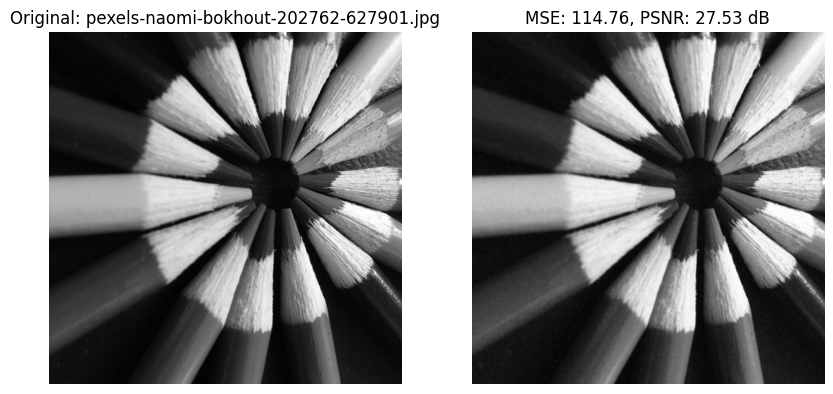

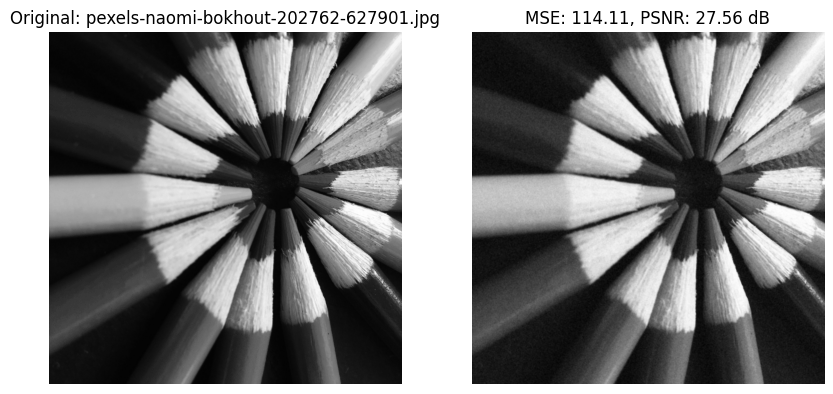

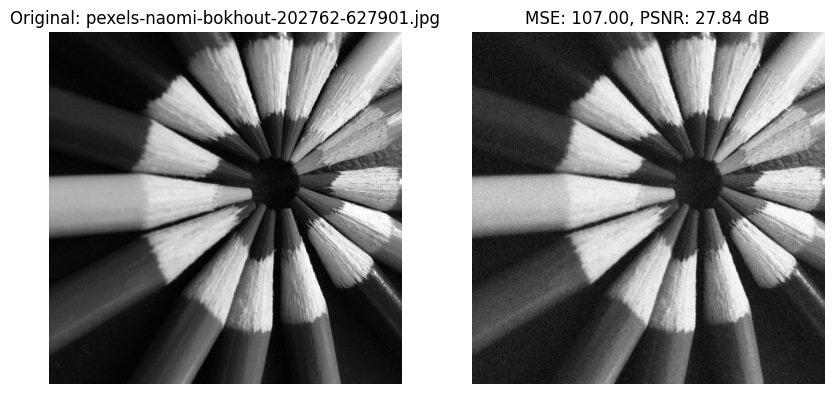

avarage mse = 106.08953036105173
avarage psnr = 27.8869266915318


In [82]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

The bilateral filter results on Gaussian are very similar to the Gaussian filter. A big average MSe although the images look very smooth, that's because the noise smoothes the images, and the filter deals with that by further smoothing it.

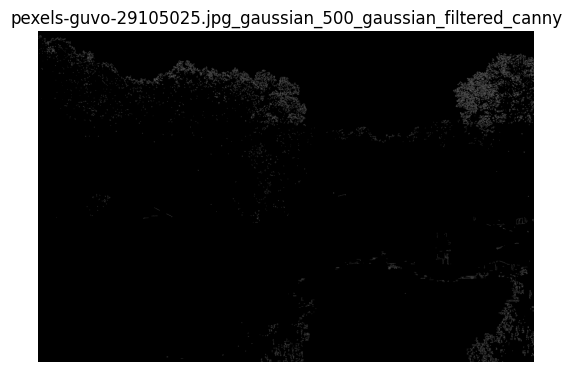

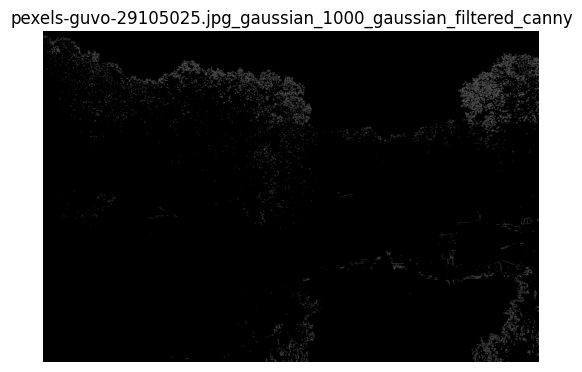

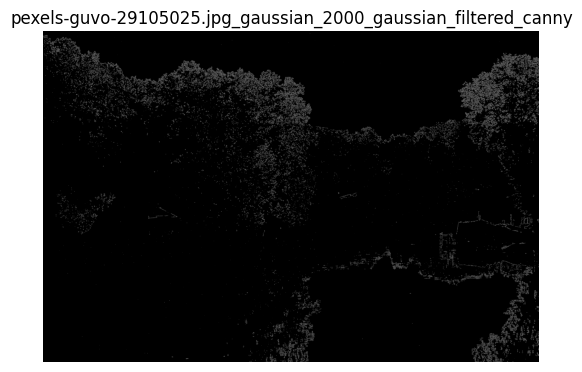

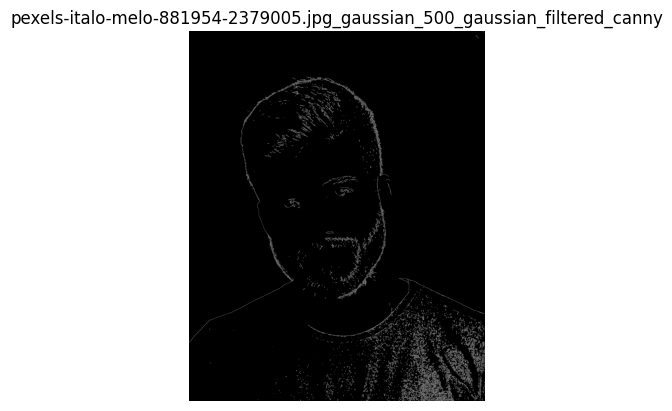

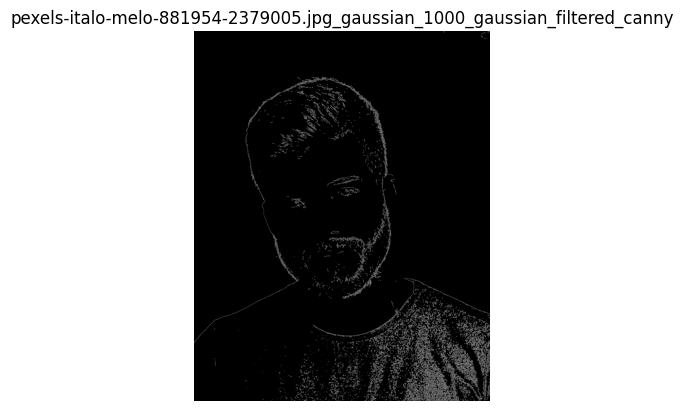

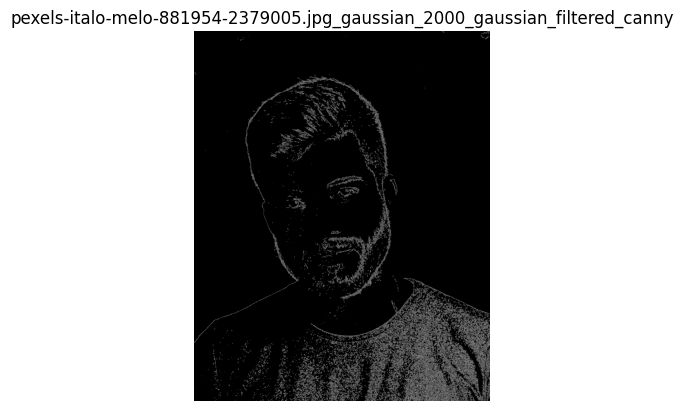

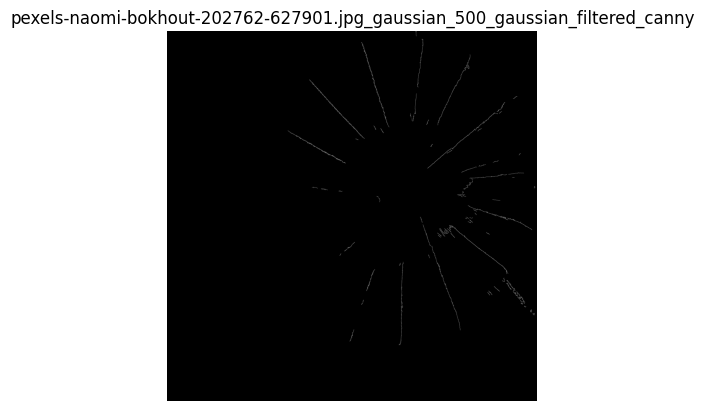

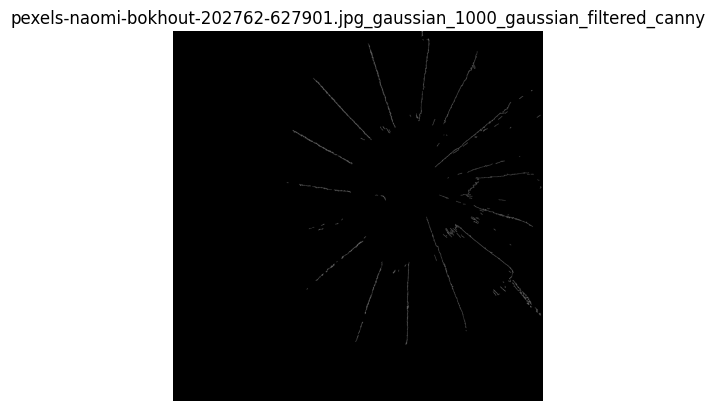

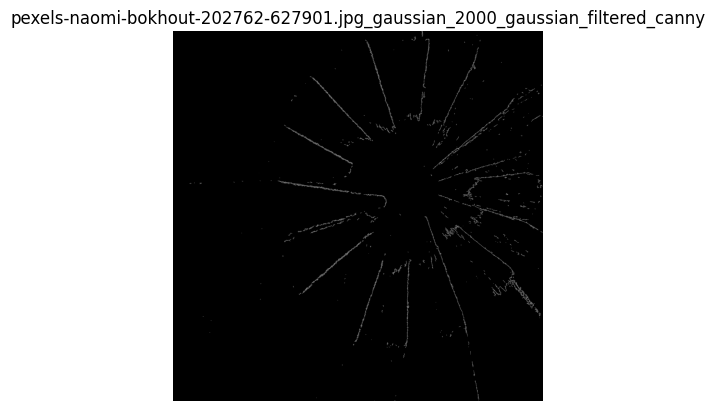

In [74]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

However, the bilateral filter preserved the images' edges much better than the Gaussian filter. Canny could still detect the edges in all the images, as they weren't lost to the filter's smoothing.

In [83]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=0.5, kernel_size=20, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_gaussian_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 12.8749 seconds


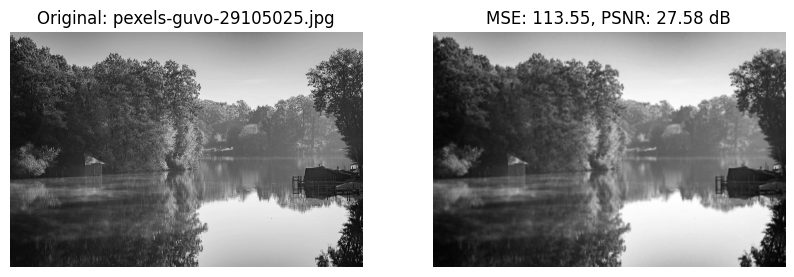

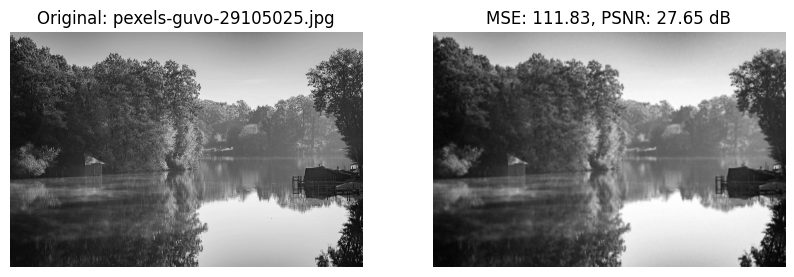

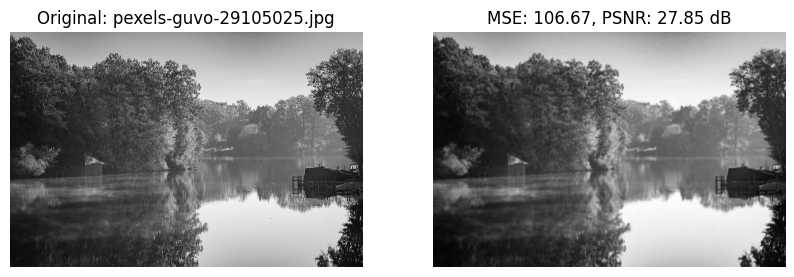

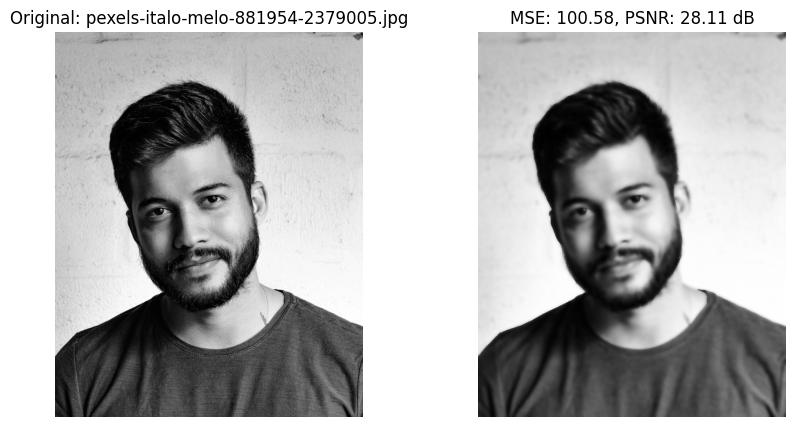

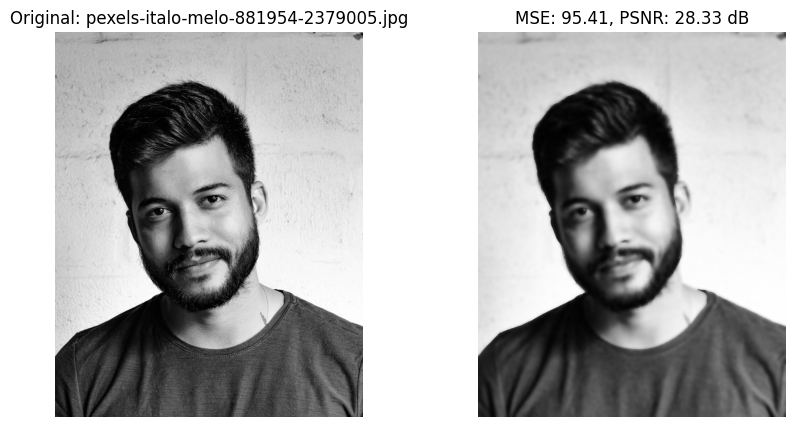

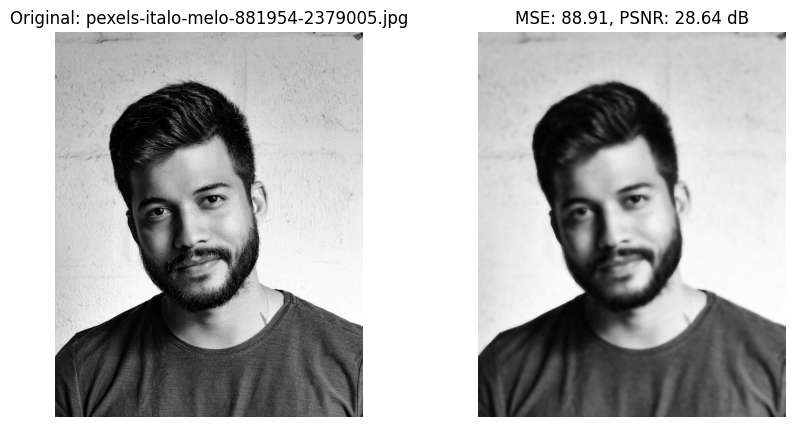

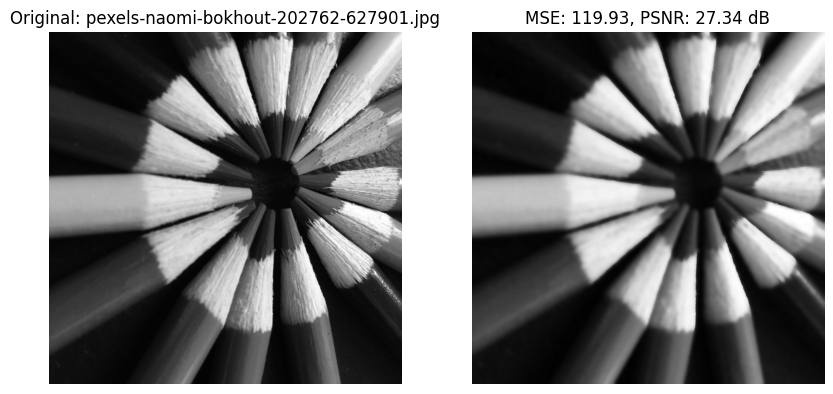

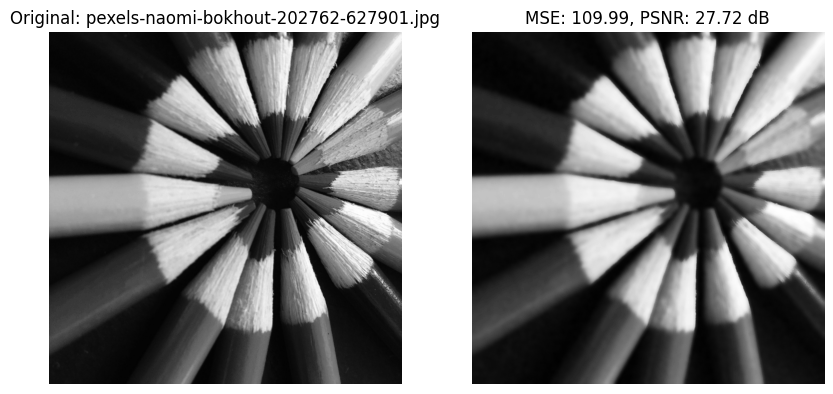

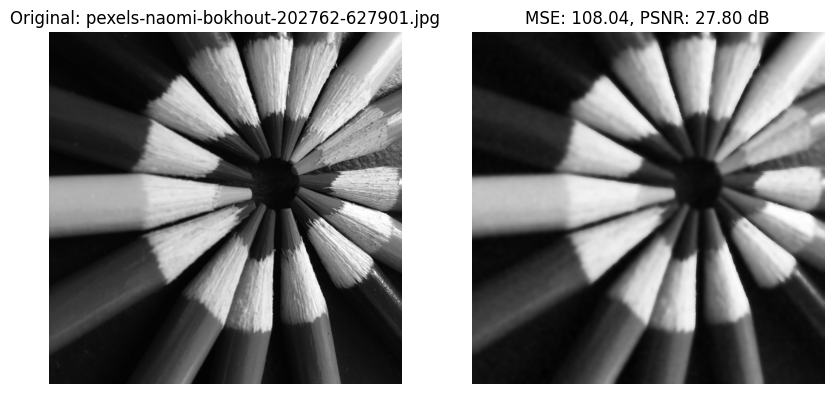

avarage mse = 106.09962049304852
avarage psnr = 27.890075006228837


In [84]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

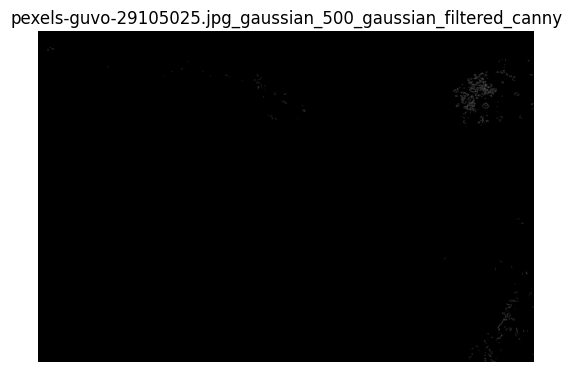

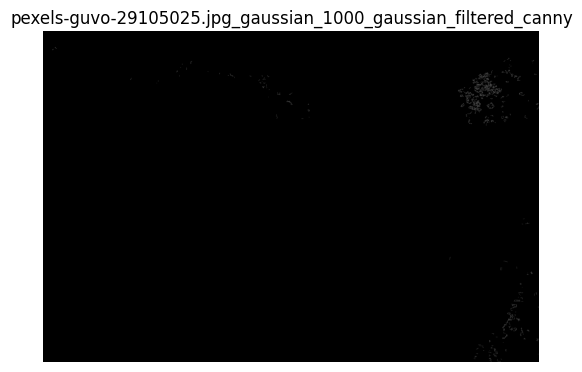

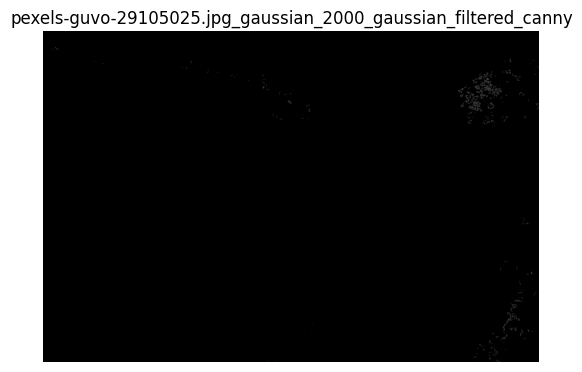

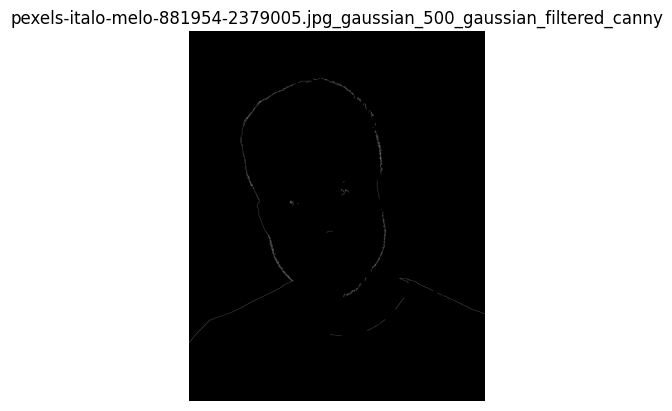

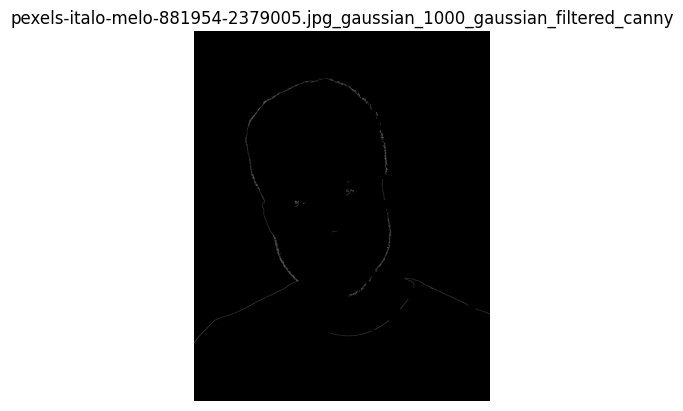

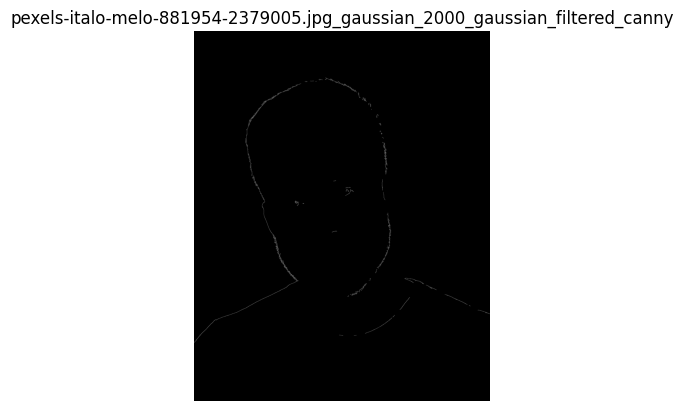

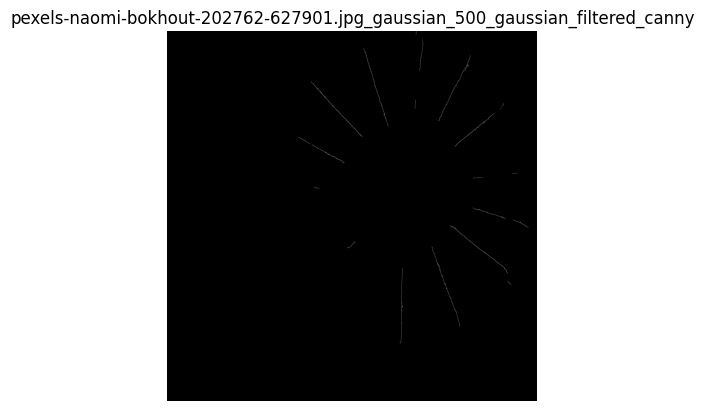

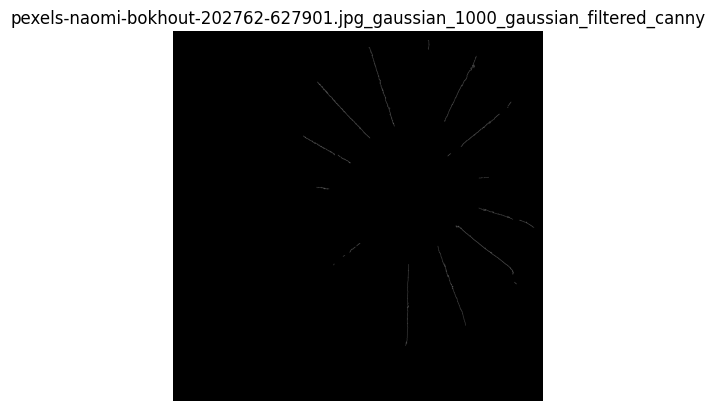

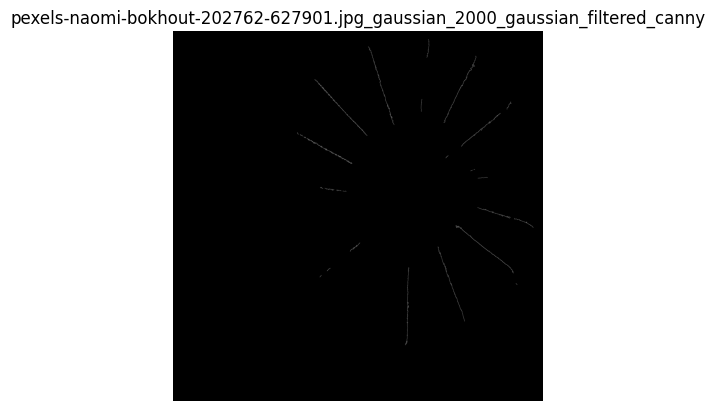

In [78]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

This time the filter was too harsh. It smoothed the image too much that some of the details were sacrificed for the noise. But still unlike Gaussian filter, the strong edges were still detected by Canny in all images.

# Poisson Noise:

In [86]:
def add_poisson_noise(image):
    noisy_image = np.random.poisson(image).astype(np.uint8)
    noisy_image = np.clip(noisy_image, 0, 255)
    return noisy_image

noisy_data_poisson = []

for index, row in original.iterrows():
    noisy_img = add_poisson_noise(row['image'])
    noisy_data_poisson.append({
        'filename': f"{row['filename']}_poisson",
        'image': noisy_img,
        'noise_type': 'poisson'
    })

noisy_poisson = pd.DataFrame(noisy_data_poisson)

In [90]:
Computational_times["Poisson"] = []
average_MSE["Poisson"] = []
average_psnr["Poisson"] = []

In [91]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=1, kernel_size=10, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_bilateral_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 4.3406 seconds


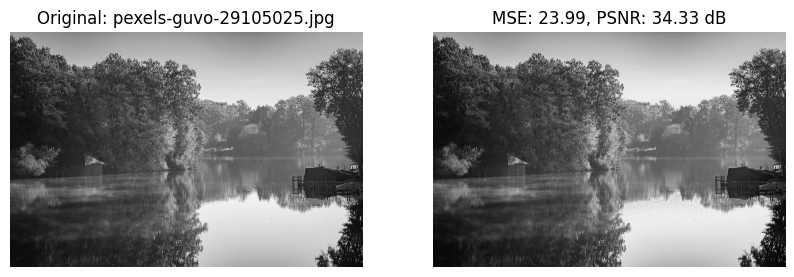

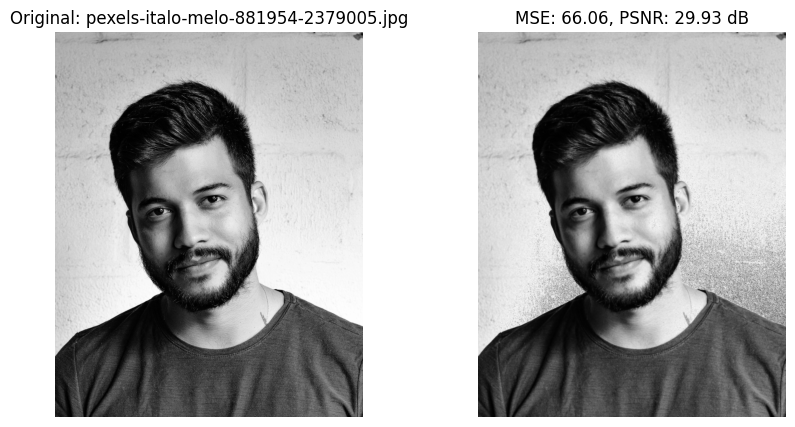

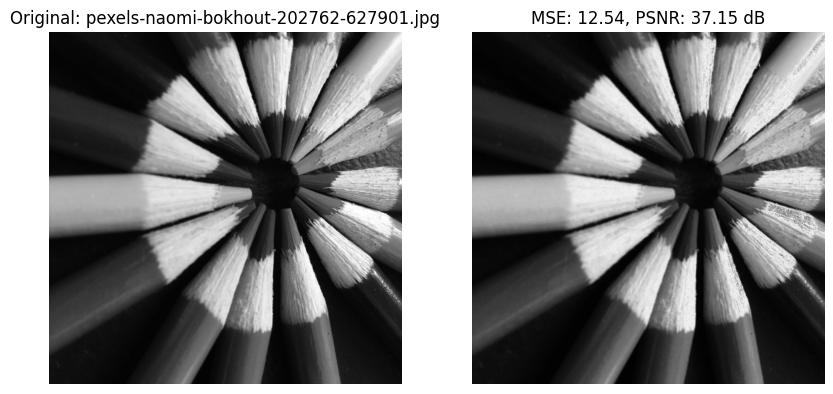

avarage mse = 34.19738856054274
avarage psnr = 33.80274897147445


In [92]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

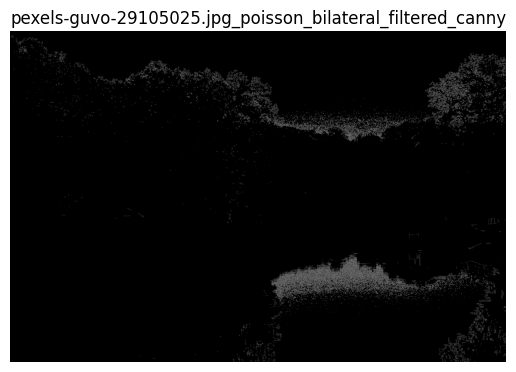

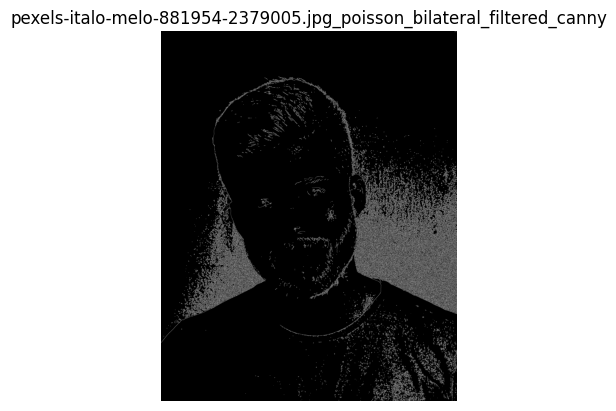

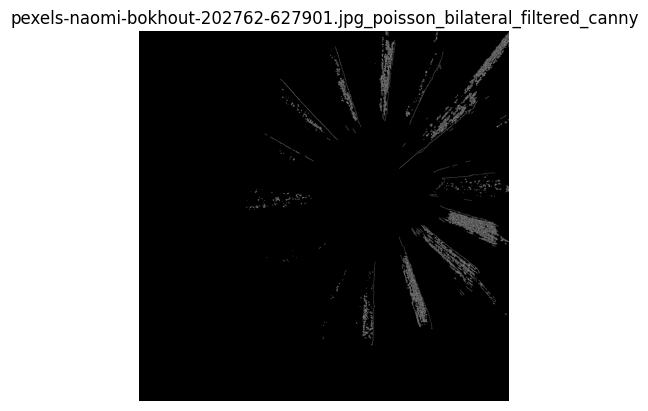

In [93]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

The filter didn't get rid of all the noise, maybe its smoothing needs to be increased?

In [94]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=0.5, kernel_size=20, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_bilateral_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 5.1609 seconds


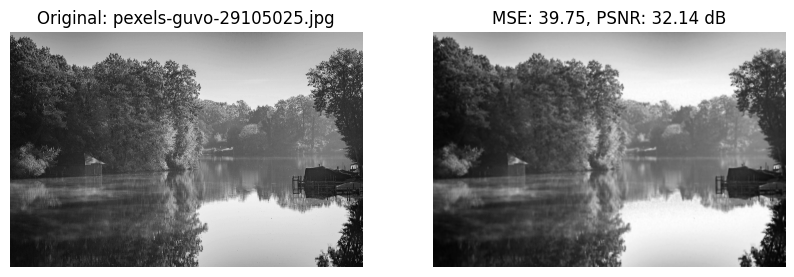

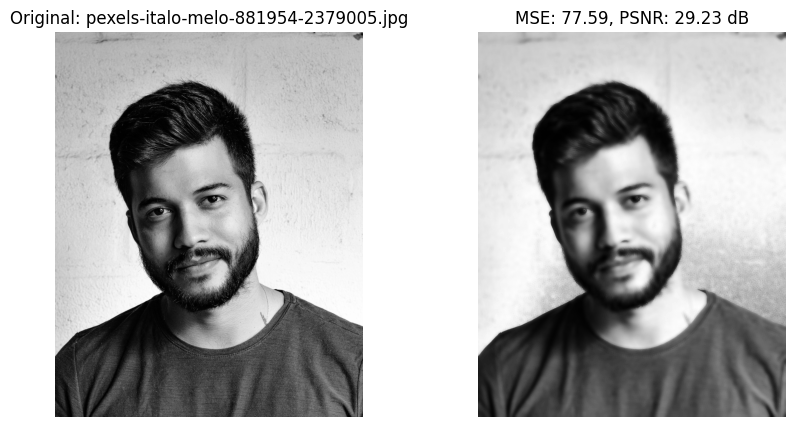

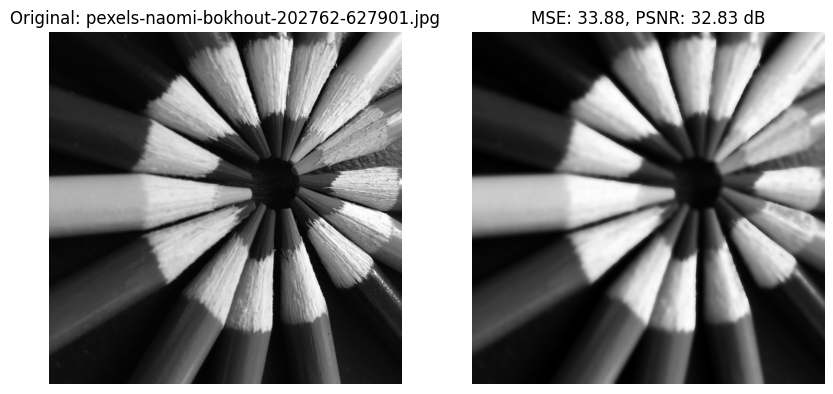

avarage mse = 50.40548417646067
avarage psnr = 31.40055690990488


In [95]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

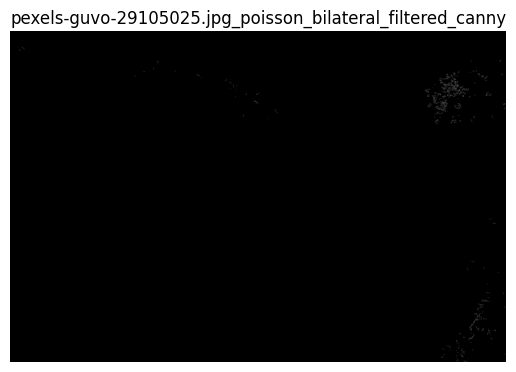

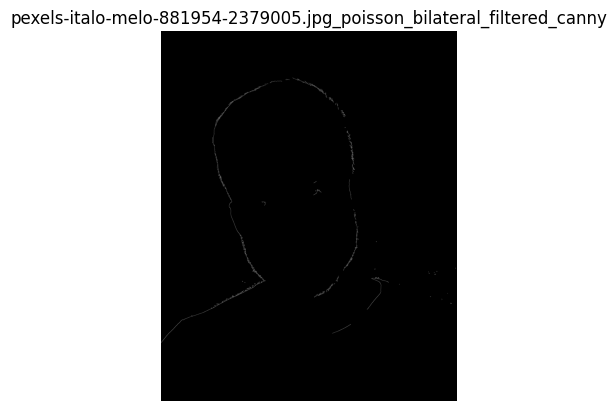

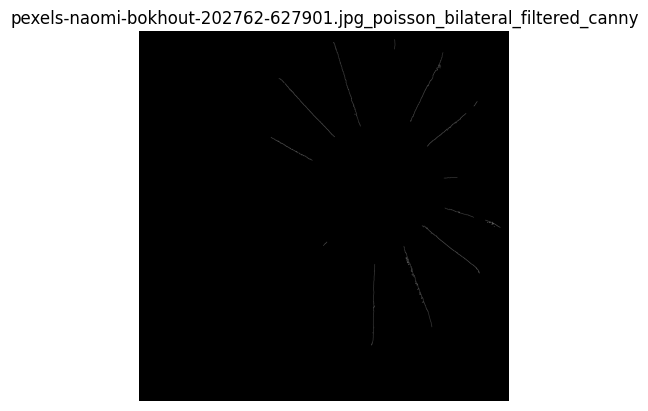

In [96]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

The images were smoothed too much some of the details were lost. However, the strong edges were still preserved.

# Speckle Noise:

In [98]:
def generate_speckle_noise(image_shape, mean=0, variance=0.01):
    noise = np.random.normal(mean, variance**0.5, size=image_shape)
    speckle_noise = noise * np.ones(image_shape)
    return speckle_noise

def add_speckle_noise(image, mean=0, variance=0.1):
    speckle_noise = generate_speckle_noise(image.shape, mean=mean, variance=variance)
    noisy_image = image + image * speckle_noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

speckle_variances = [0.05, 0.1, 0.2]

noisy_data_speckle = []

for index, row in original.iterrows():
    for var in speckle_variances:
        noisy_img = add_speckle_noise(row['image'], variance=var)
        noisy_data_speckle.append({
            'filename': f"{row['filename']}_speckle_{var}",
            'image': noisy_img,
            'variance': var
        })

speckle_noise = pd.DataFrame(noisy_data_speckle)

In [99]:
Computational_times["Speckle"] = []
average_MSE["Speckle"] = []
average_psnr["Speckle"] = []

In [101]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=1, kernel_size=10, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_bilateral_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 13.4252 seconds


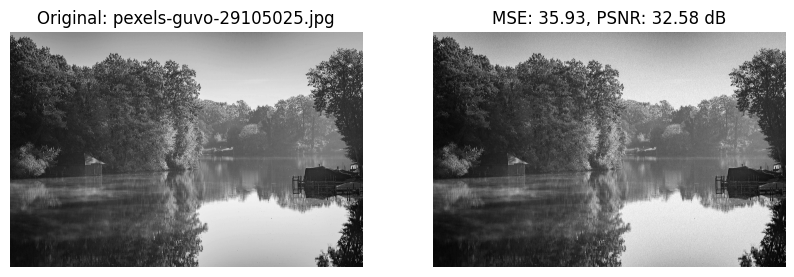

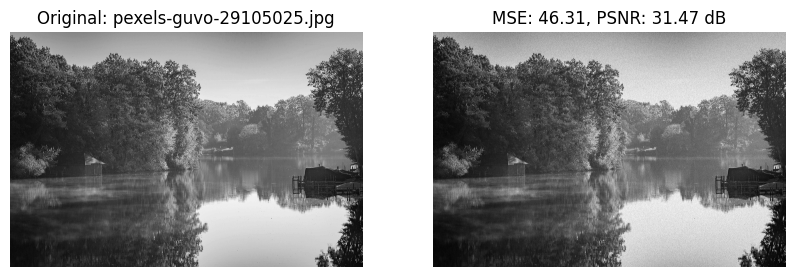

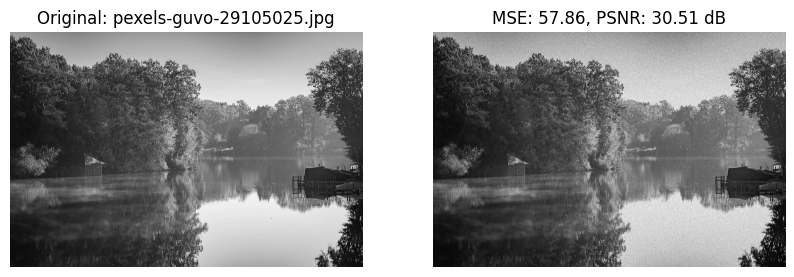

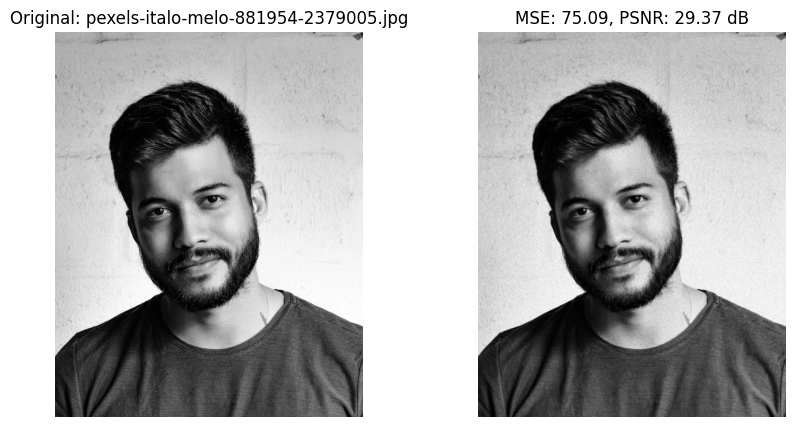

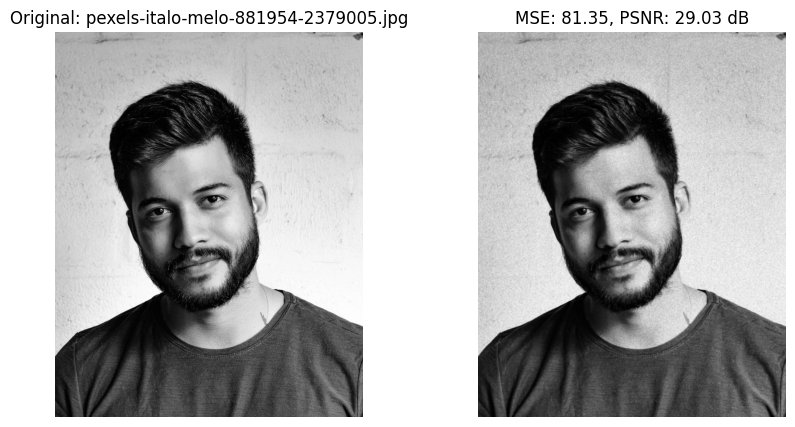

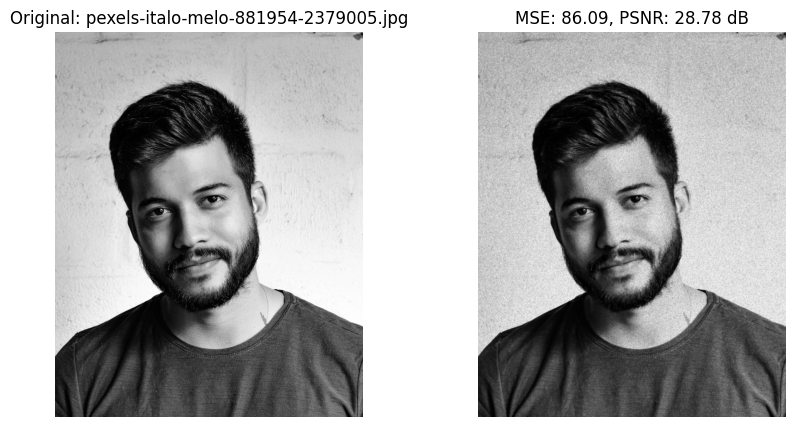

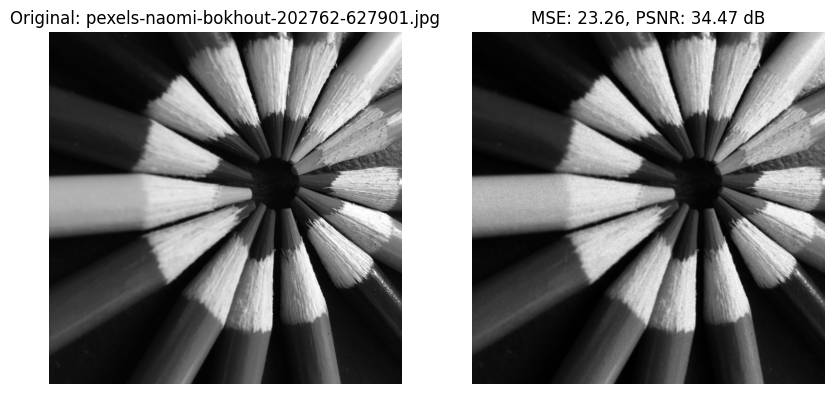

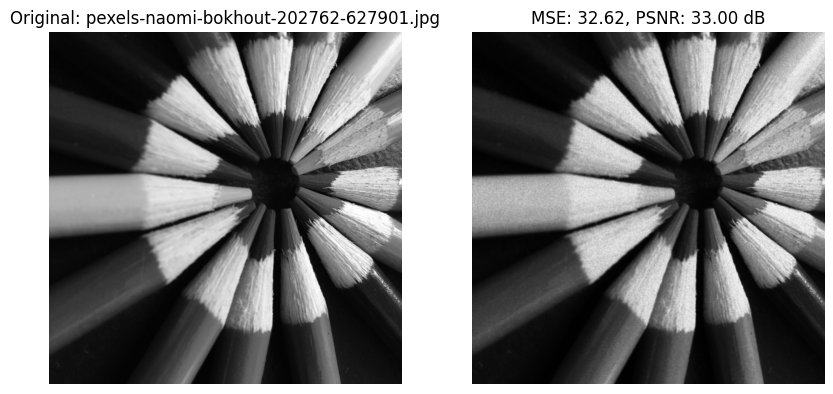

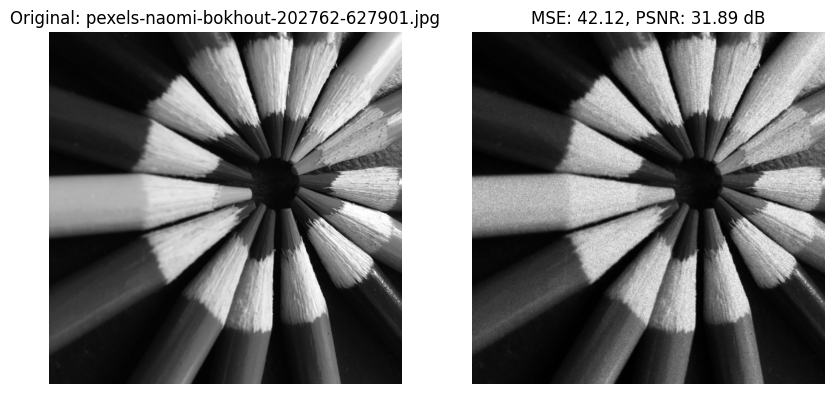

avarage mse = 53.40313506943468
avarage psnr = 31.232010283697093


In [102]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

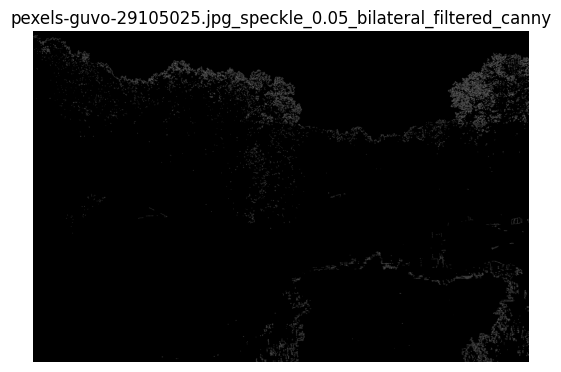

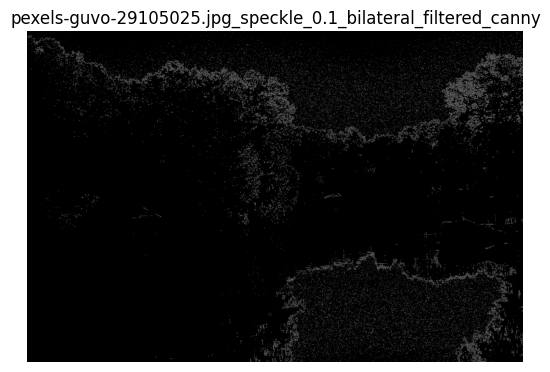

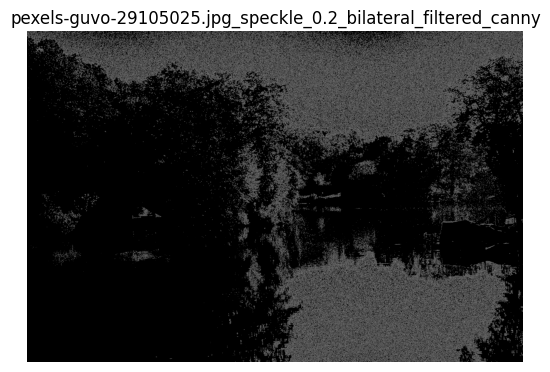

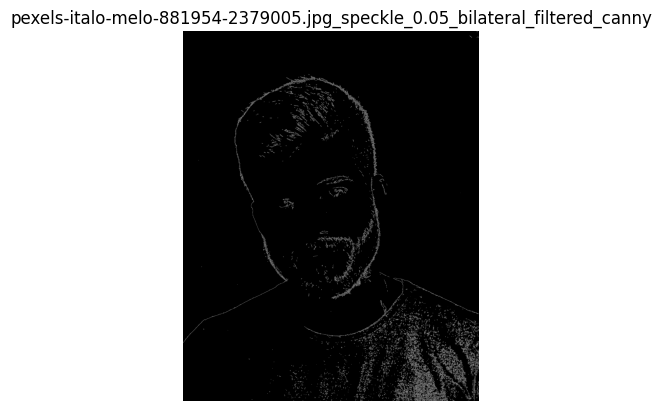

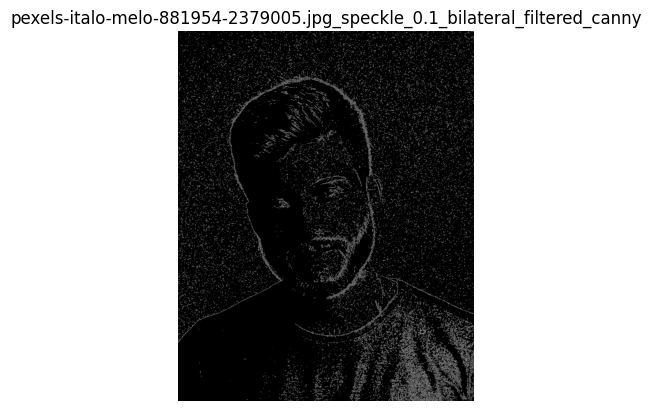

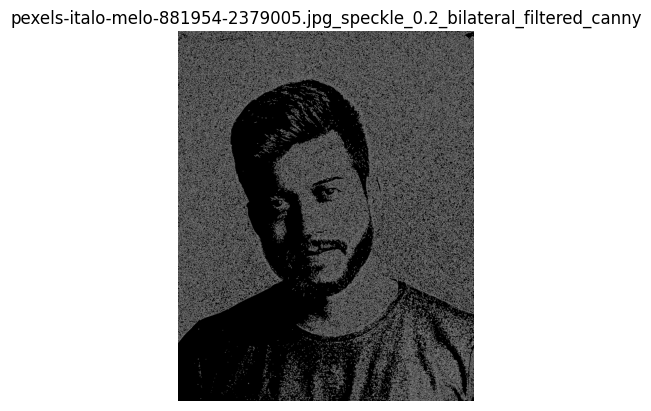

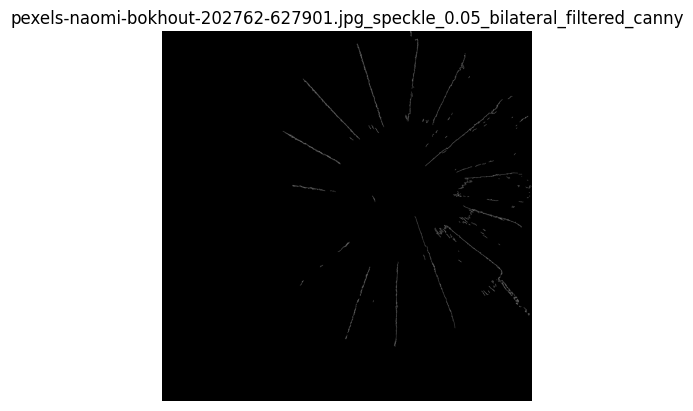

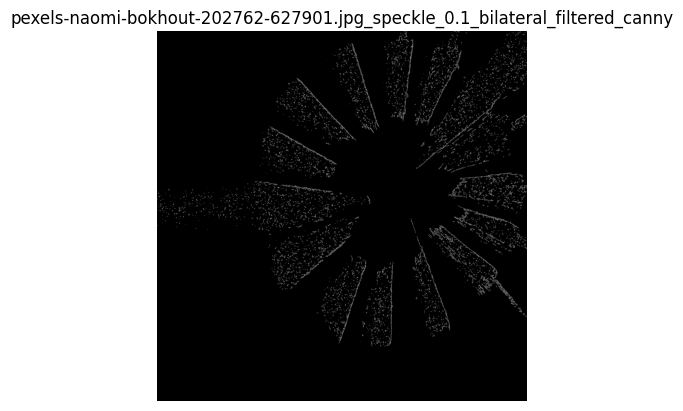

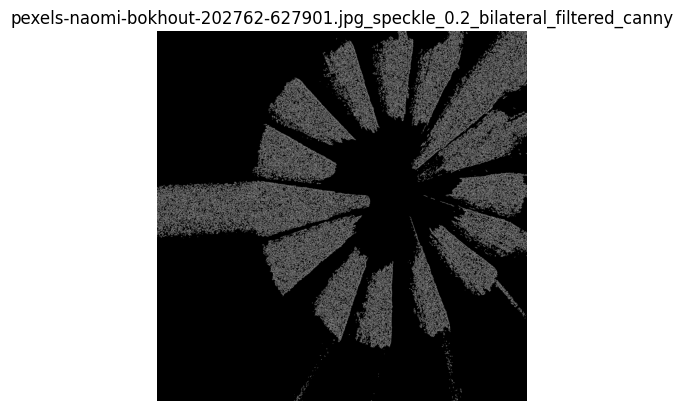

In [103]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

The images were too noisy for the filter. The filter effects need to be increased to prevent the noise from being detected as edges.

In [104]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = apply_Bilateral_filter(image=row['image'], scale=0.5, kernel_size=20, sigma_color=100, sigma_space=100)
    filtered_data.append({
        'filename': f"{row['filename']}_bilateral_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying Bilateral filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying Bilateral filter: 14.9012 seconds


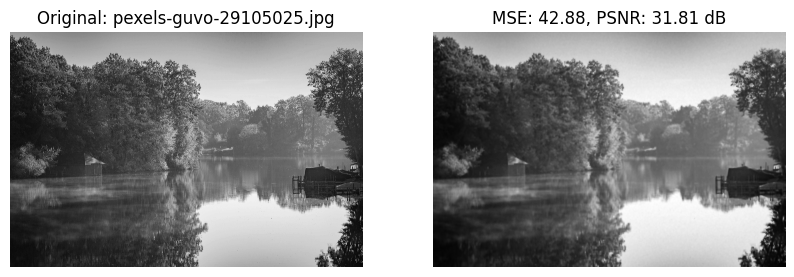

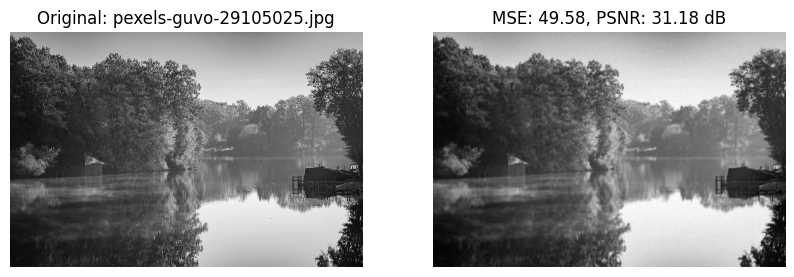

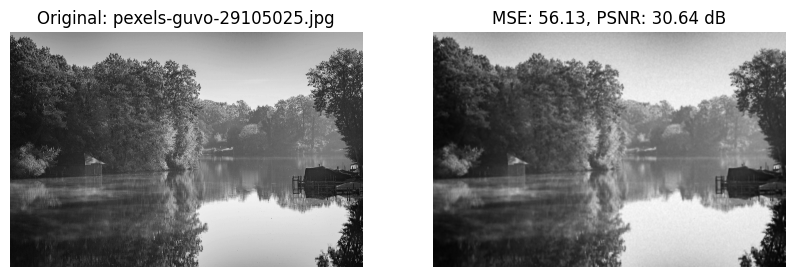

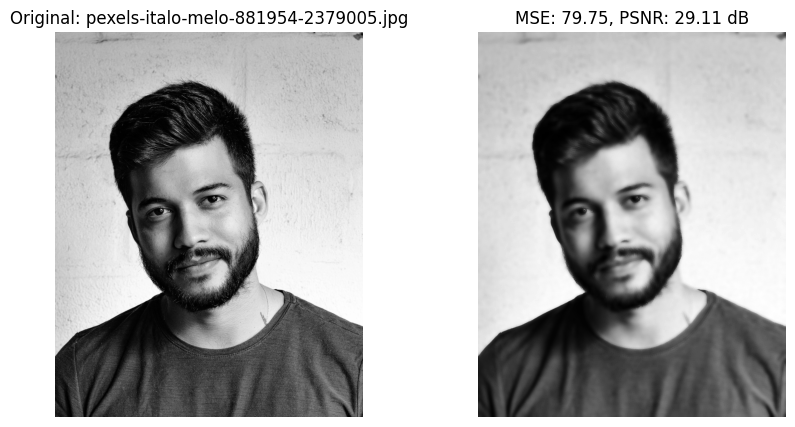

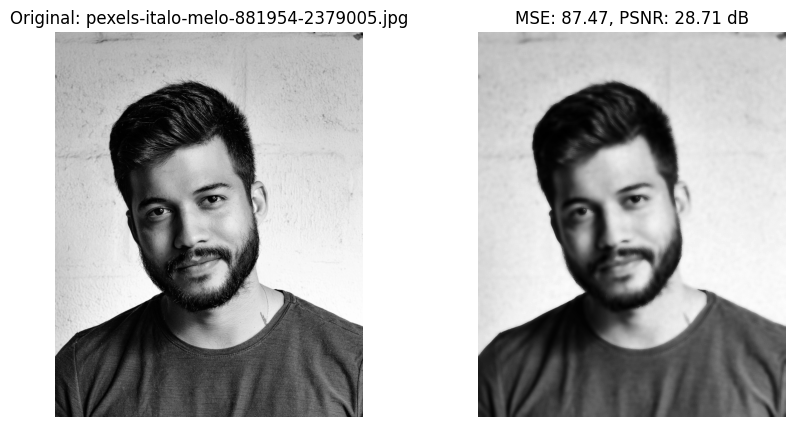

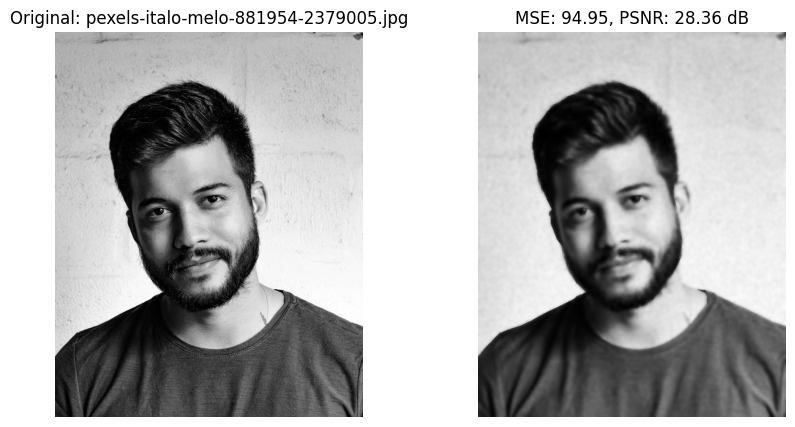

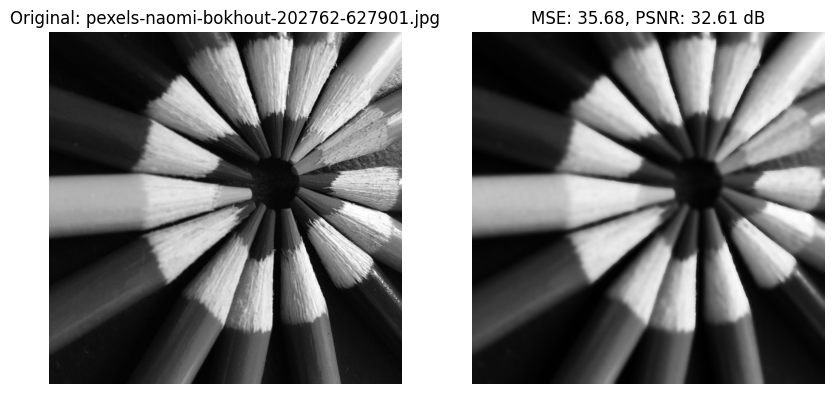

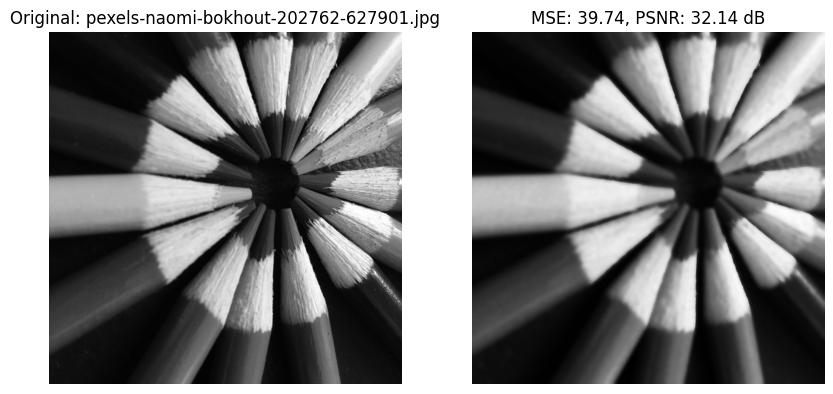

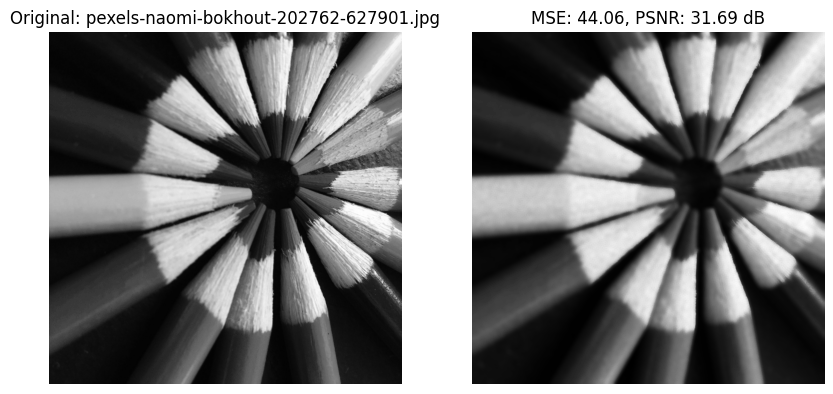

avarage mse = 58.91561344158582
avarage psnr = 30.69355187268217


In [105]:
counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

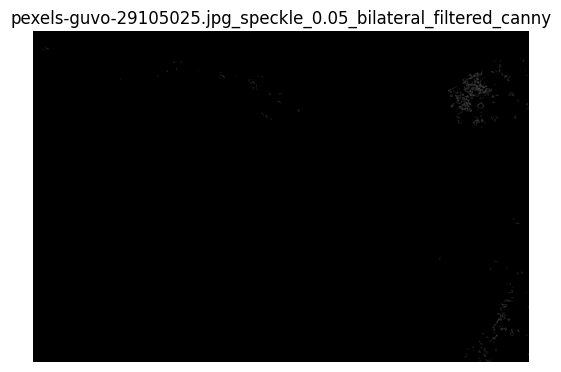

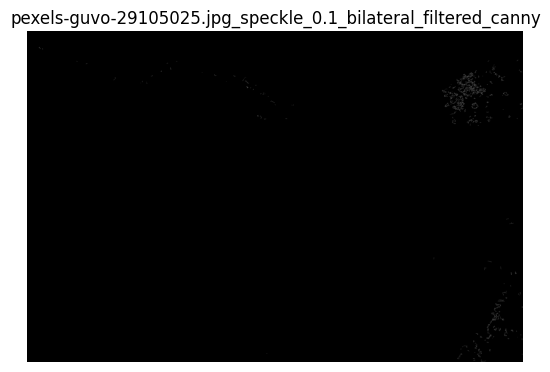

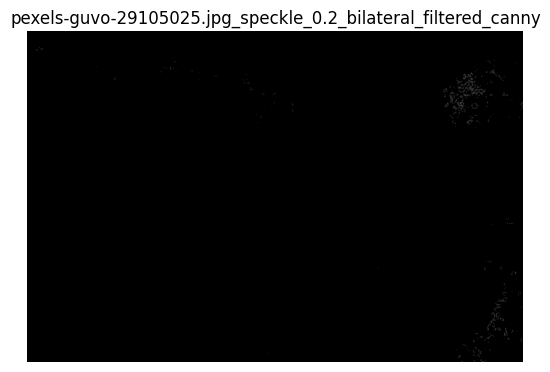

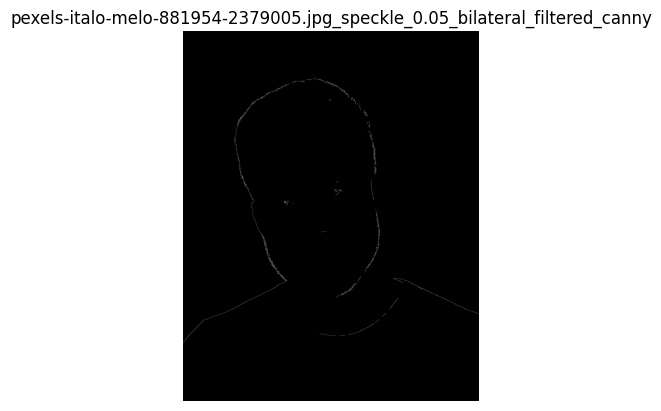

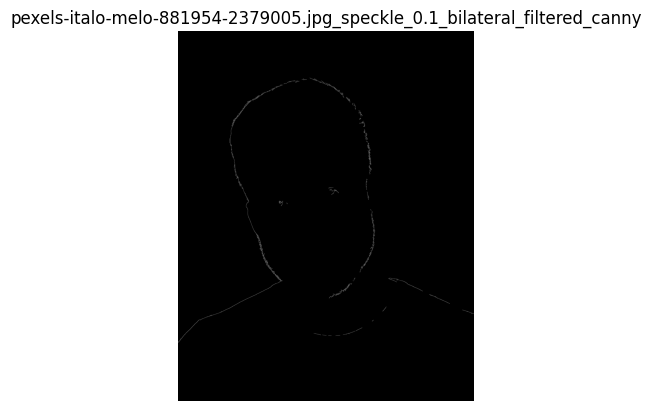

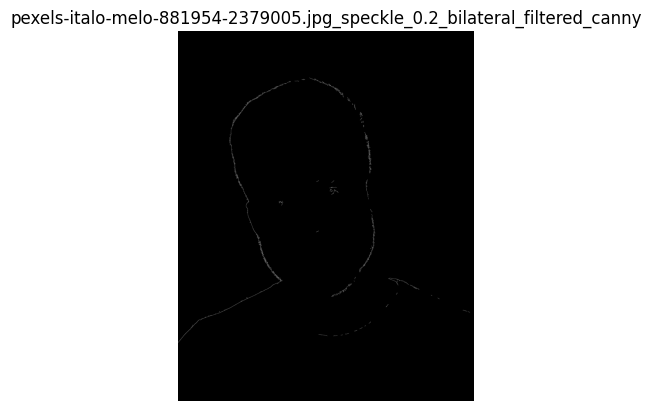

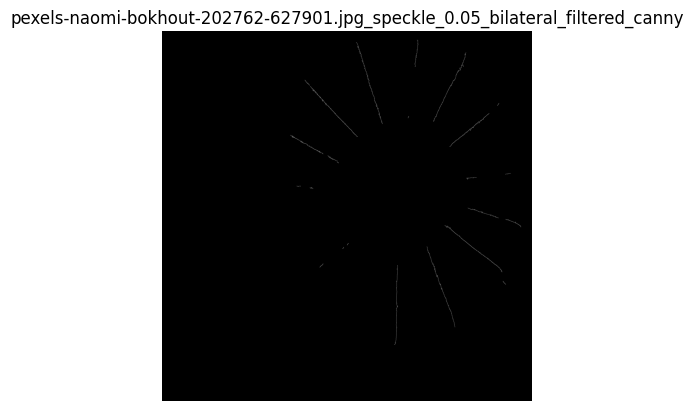

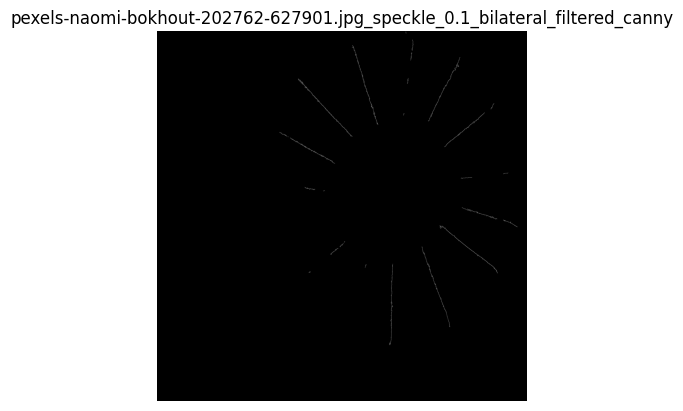

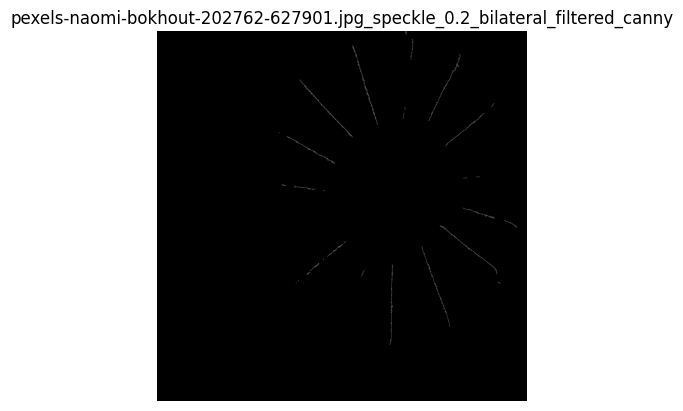

In [106]:
canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Even with the filter's smoothing/bluring increased, the filter still avoided damaging the image's skeleton edges, to the point Canny wouldn't detect them.



However, it's worth noting that images with a lot of details suffer the most with a bilateral filter. That's because most of the edges in these images tend to be weak edges. And weak edges are overlooked by the filter, as they're hard to differentiate from noise.

# Results:

In [108]:
comp_times_df = pd.DataFrame(Computational_times, index=['scale=1, kernel N=10', 'scale=0.5, kernel=20']).T
mse_df = pd.DataFrame(average_MSE, index=['scale=1, kernel N=10', 'scale=0.5, kernel=20']).T
psnr_df = pd.DataFrame(average_psnr, index=['scale=1, kernel N=10', 'scale=0.5, kernel=20']).T

In [109]:
print("Computational Times:")
comp_times_df.style.set_caption("Computational Times").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Computational Times:


,"scale=1, kernel N=10","scale=0.5, kernel=20"
Salt and Pepper,13.108300,14.391395
Gaussian,14.085028,12.874880
Poisson,4.340628,5.160887
Speckle,13.425235,14.901189


Even after rescaling the image to half its original size before applying the filter, the computational time of the bigger kernel is still the same or longer than applying it with a smaller kernel.




Overall, the bilateral filter computational time for both kernels is way longer than other simpler filters, like the Box filter for example, even with less images to process.

In [110]:
print("Average MSEs:")
mse_df.style.set_caption("Average MSEs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average MSEs:


,"scale=1, kernel N=10","scale=0.5, kernel=20"
Salt and Pepper,44.387561,70.390713
Gaussian,106.089530,106.099620
Poisson,34.197389,50.405484
Speckle,53.403135,58.915613


The average MSEs are better than other filters, as the edges here were kept intact. That's why the MSE didn't go up by a lot with a bigger kernel for the Gaussian and Speckle noise. The filter smoothed out the errors without damaging the image.




However, for the salt and pepper noise, and the Poisson noise with the smaller kernel, the filter confused the noise with actual edges. The bigger kernel was better with that, but it was also harder with its blurring.

In [111]:
print("Average PSNRs:")
psnr_df.style.set_caption("Average PSNRs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average PSNRs:


,"scale=1, kernel N=10","scale=0.5, kernel=20"
Salt and Pepper,32.369015,29.957786
Gaussian,27.886927,27.890075
Poisson,33.802749,31.400557
Speckle,31.232010,30.693552


The PSNR indicate preservation of fine details, so it's no surprise that the Bilateral filter did better than simple filters. The spatial and color information that the filter took care to Consider, made sure the filter didn't damage strong edges (or weak to median edges depending on the filter parameters), which made sure the image details were Maintained.